In [7]:
import sys
fwqc_path = "/geophysics2/dpelacani/acse-9-independent-research-project-dekape/"
sys.path.insert(0, fwqc_path)  

%load_ext autoreload
%autoreload 2

import numpy as np
import matplotlib.pyplot as plt
from fullwaveqc import tools, geom, siganalysis, inversion, visual
import copy
import warnings

%reload_ext autoreload
path = "/geophysics2/dpelacani/PROJECTS/"

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Introduction
This notebook serves to demonstrate the main findings and conclusions over most of the inversion workflows implemented with Fullwave3D for this project. Here we describe these models as an evolution of parameter adjustments and how these served to guide the final inversion towards a better result.

The creation of the FullwaveQC package was an idea that arose out of necessity to quality check the already produced models and see how those could be further enhanced. This notebook aims to describe the difficulties encountered with the inversions prior the QC package, up until model PARBASE25_7, and how the package was used to produce the final model (PARBASE25_12).

At the end of the project, we developed and hereby propose the most sustainable method of using the FullwaveQC package as a complementary quality-check of the inputs and outputs of Fullwave3D. An example of the implementation of this workflow can be found in the "PARBASE_MON_DIFF25_12" notebook in the examples" folder of this github repository.

# TRUE MODELS

In [72]:
TRUE_BASE = tools.load("/geophysics2/dpelacani/true_models/Base/TRUE_enl_Vp_bl_y6250.sgy", model=True, verbose=1)
TRUE_BASE.dx=2.
TRUE_MON = tools.load("/geophysics2/dpelacani/true_models/Monitor/TRUE_enl_Vp_mon_y6250.sgy", model=True, verbose=1)
TRUE_MON.dx = 2.


2019-08-07 11:12:17.912745 	 Opening file /geophysics2/dpelacani/true_models/Base/TRUE_enl_Vp_bl_y6250.sgy...
2019-08-07 11:12:17.916598 	 Reading model...

/geophysics2/dpelacani/acse-9-independent-research-project-dekape/fullwaveqc/tools.py:171: UserWarning: Zero or negative model spacing. File might not have been loaded correctly.Check manually!
  warnings.warn("Zero or negative model spacing. File might not have been loaded correctly."



2019-08-07 11:12:18.268800 	 Successfully loaded model of size 2500 x 8245!
2019-08-07 11:12:18.289748 	 Opening file /geophysics2/dpelacani/true_models/Monitor/TRUE_enl_Vp_mon_y6250.sgy...
2019-08-07 11:12:18.293011 	 Reading model...
2019-08-07 11:12:18.704165 	 Successfully loaded model of size 2500 x 8245!

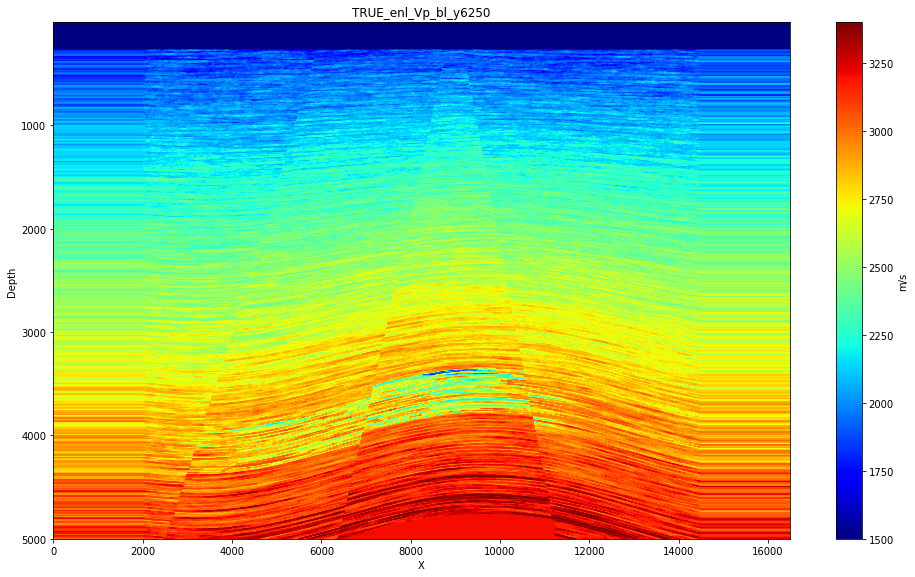

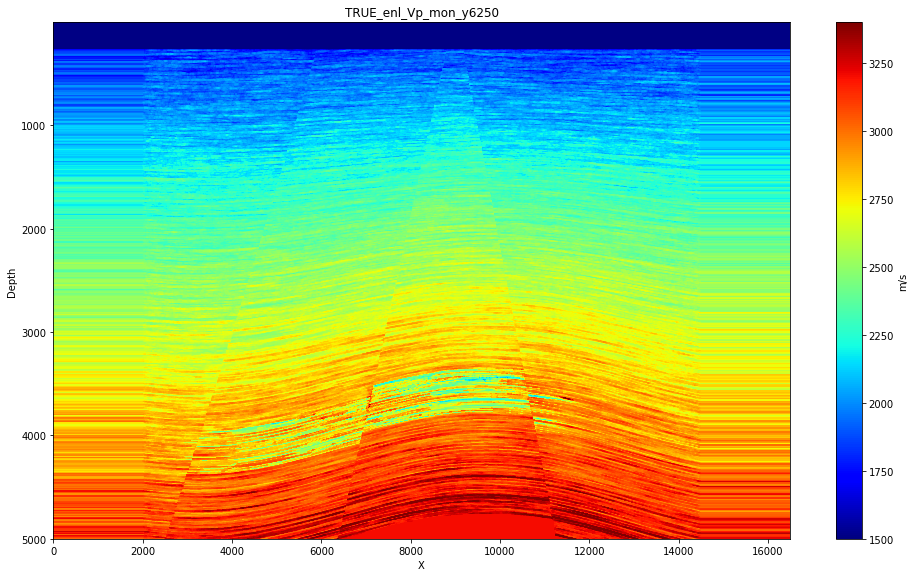

In [74]:
# Visualise true model
visual.vpmodel(TRUE_BASE, vmin=1500, vmax=3400)
visual.vpmodel(TRUE_MON, vmin=1500, vmax=3400)

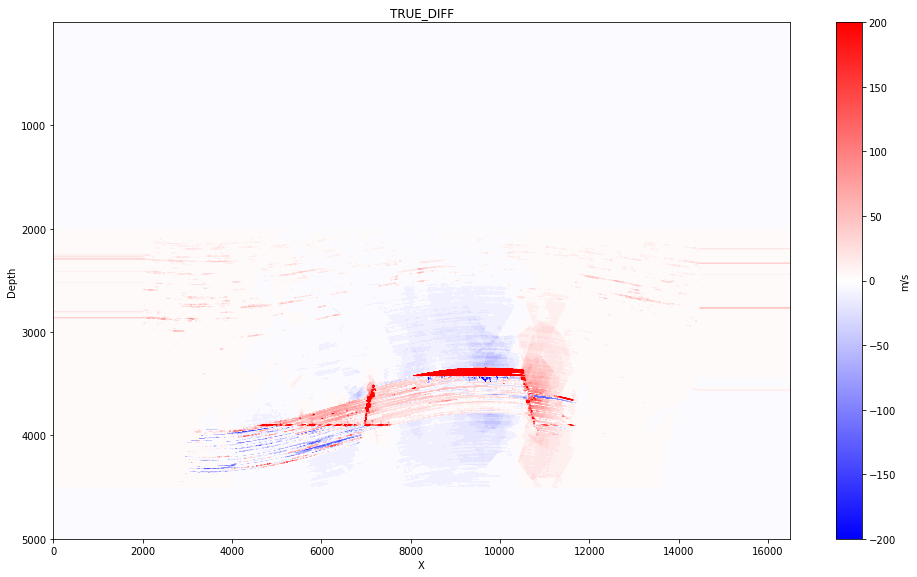

In [111]:
# Compute and visualise True Difference
TRUE_DIFF = copy.deepcopy(TRUE_BASE)
TRUE_DIFF.name = "TRUE_DIFF"
TRUE_DIFF.data = TRUE_MON.data - TRUE_BASE.data
visual.vpmodel(TRUE_DIFF, cmap="bwr", vmin=-200, vmax=200)

# Starting Linear Model


2019-08-07 12:31:19.478484 	 Opening file /geophysics2/dpelacani/starting_models/initial_vp25.sgy...
2019-08-07 12:31:19.483666 	 Reading model...
2019-08-07 12:31:19.498097 	 Successfully loaded model of size 201 x 661!

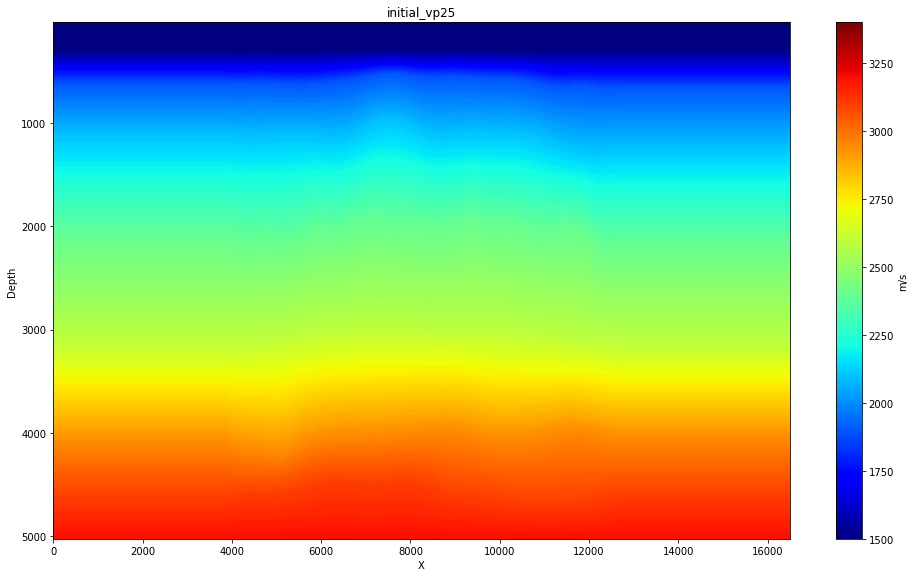

In [107]:
START_PARALLEL = tools.load("/geophysics2/dpelacani/starting_models/initial_vp25.sgy", model=True)
START_PARALLEL.dx = 25.
visual.vpmodel(START_PARALLEL, vmin=1500, vmax=3400)

(201,)


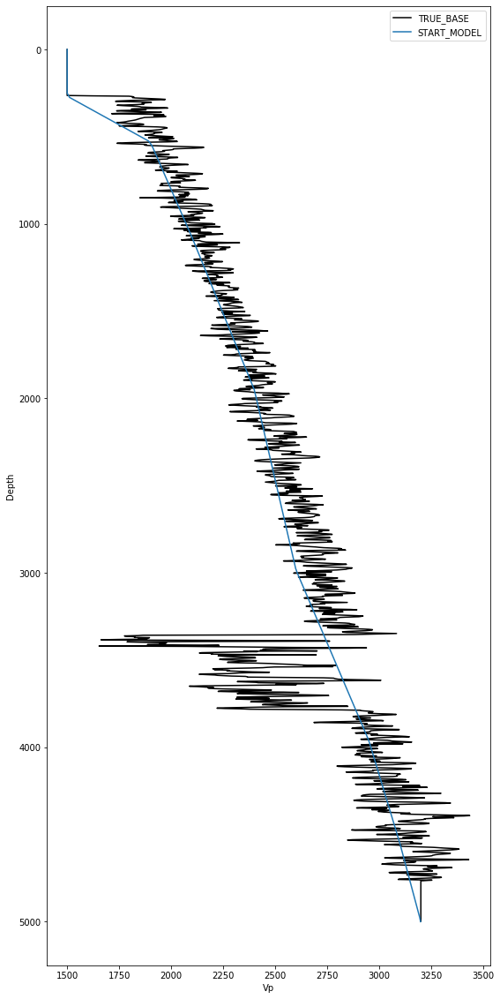

In [108]:
x_list = [9000]
s  = visual.vpwell(START_PARALLEL, pos_x=x_list, plot=False)[0]
wb = visual.vpwell(TRUE_BASE, pos_x=x_list, plot=False)[0]
print(w.shape)

y =  np.arange(0, w.shape[0], 1) * START_PARALLEL.dx
yb =  np.arange(0, wb.shape[0], 1) * TRUE_BASE.dx

figure, ax = plt.subplots(1, 1)
figure.set_size_inches(9, 20)
ax.plot(wb, yb, 'k', label="TRUE_BASE")
ax.plot(s, y, label="START_MODEL")
ax.set_ylabel("Depth")
ax.set_xlabel("Vp")
ax.invert_yaxis()
ax.legend(loc="best")
plt.show()

# PARBASE


2019-08-07 12:29:57.453198 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE/PARBASE-CP00120-Vp.sgy...
2019-08-07 12:29:57.455408 	 Reading model...
2019-08-07 12:29:57.461971 	 Successfully loaded model of size 101 x 331!

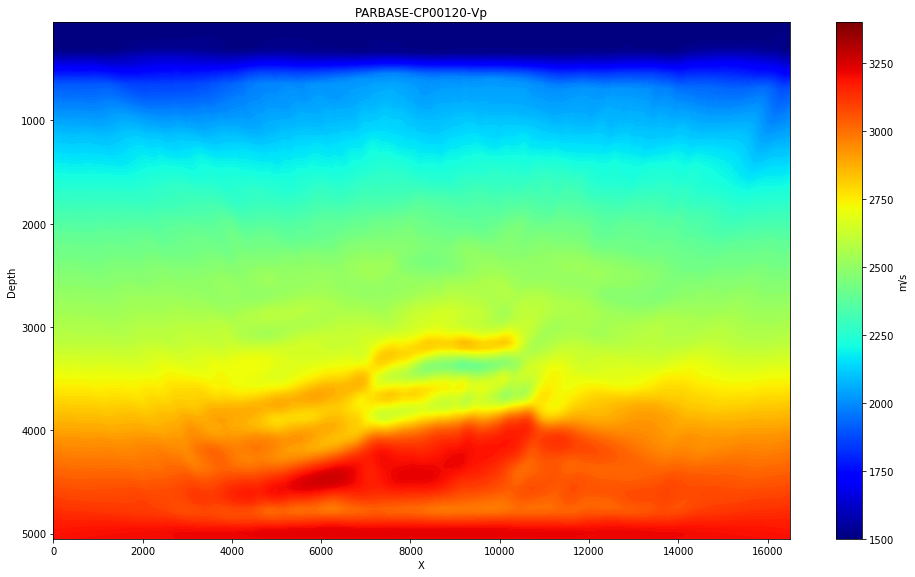

In [103]:
PARBASE = tools.load(path+"PARBASE/PARBASE-CP00120-Vp.sgy", model=True)
visual.vpmodel(PARBASE, vmin=1500, vmax=3400)

# PARBASE25


2019-08-07 10:45:04.302720 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25/PARBASE25-CP00130-Vp.sgy...
2019-08-07 10:45:04.305685 	 Reading model...
2019-08-07 10:45:04.313240 	 Successfully loaded model of size 201 x 661!

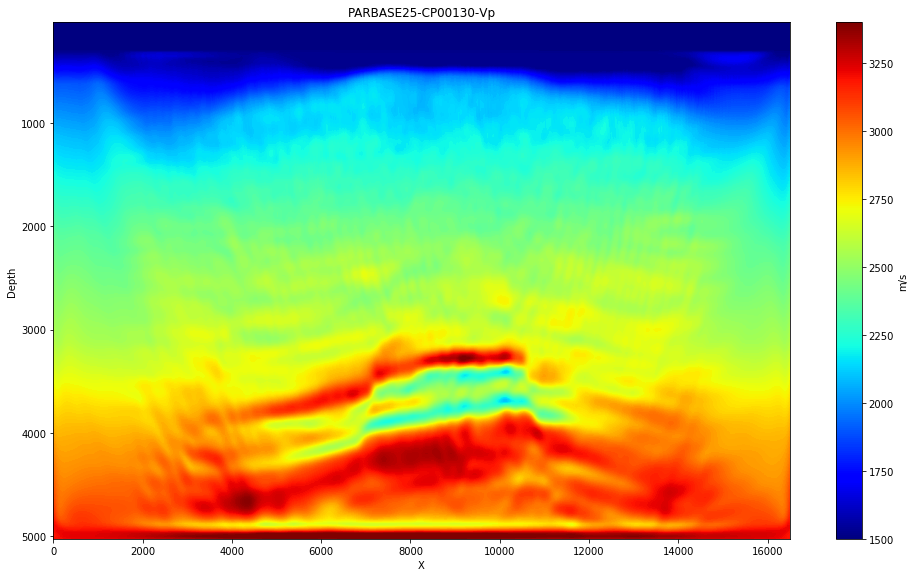

In [53]:
PARBASE25 = tools.load(path+"PARBASE25/PARBASE25-CP00130-Vp.sgy", model=True)
visual.vpmodel(PARBASE25, vmin=1500, vmax=3400)

### Here we perform a very basic quality check by producing synthetics over the final model of PARBASE25 using the same wavelet and set up. The synthetics are referenced to true shots number 241 and 242

In [48]:
# predicted shots for PARBASE25 -- referenced to true shots number 241 and 242
PARBASE25FORMIDDLE = tools.load(path+"PARBASE25FORMIDDLE/PARBASE25FORMIDDLE-Synthetic.sgy", model=False)
TRUESHOT_241 = tools.load("/geophysics2/dpelacani/res_mod_4d/Base/ucalc_shot_241.sgy", model=False)


2019-08-07 10:39:22.520235 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25FORMIDDLE/PARBASE25FORMIDDLE-Synthetic.sgy...
2019-08-07 10:39:22.522772 	 Loading data...
2019-08-07 10:39:22.671406 	 2 shots found. Loading headers...
2019-08-07 10:39:22.678423 	 1488 total traces read
2019-08-07 10:39:22.678621 	 Data loaded successfully
2019-08-07 10:39:22.678983 	 Opening file /geophysics2/dpelacani/res_mod_4d/Base/ucalc_shot_241.sgy...
2019-08-07 10:39:22.683103 	 Loading data...
2019-08-07 10:39:22.741155 	 1 shots found. Loading headers...
2019-08-07 10:39:22.743267 	 801 total traces read
2019-08-07 10:39:22.743420 	 Data loaded successfully

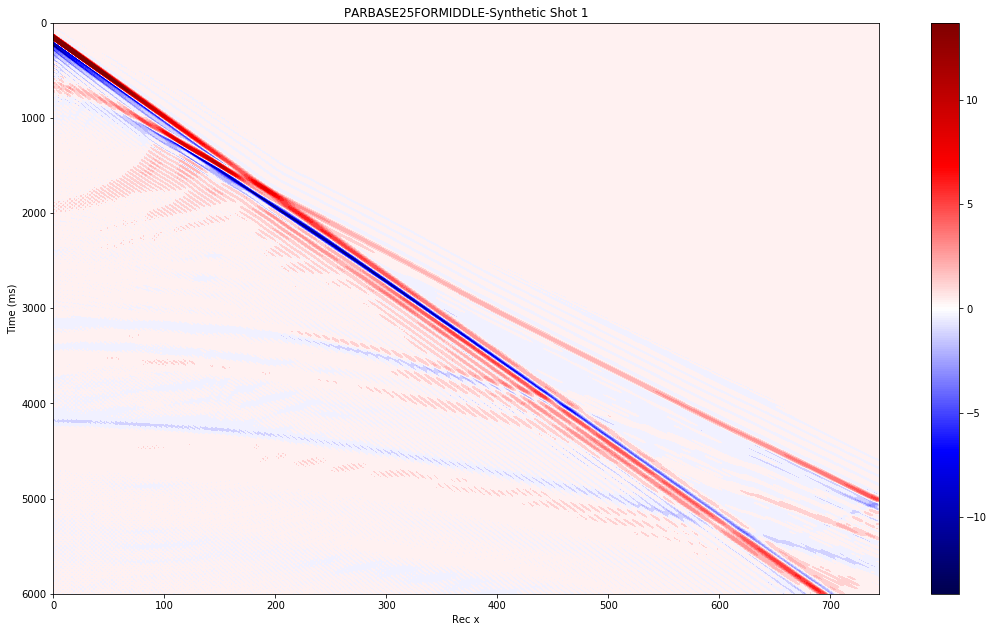

In [39]:
# Visualising the predicted shot
shot = 1
val = 0.3 * np.max(np.abs(PARBASE25FORMIDDLE.data[shot]))
visual.amplitude(PARBASE25FORMIDDLE, shot=shot, vmin=-val, vmax=val )

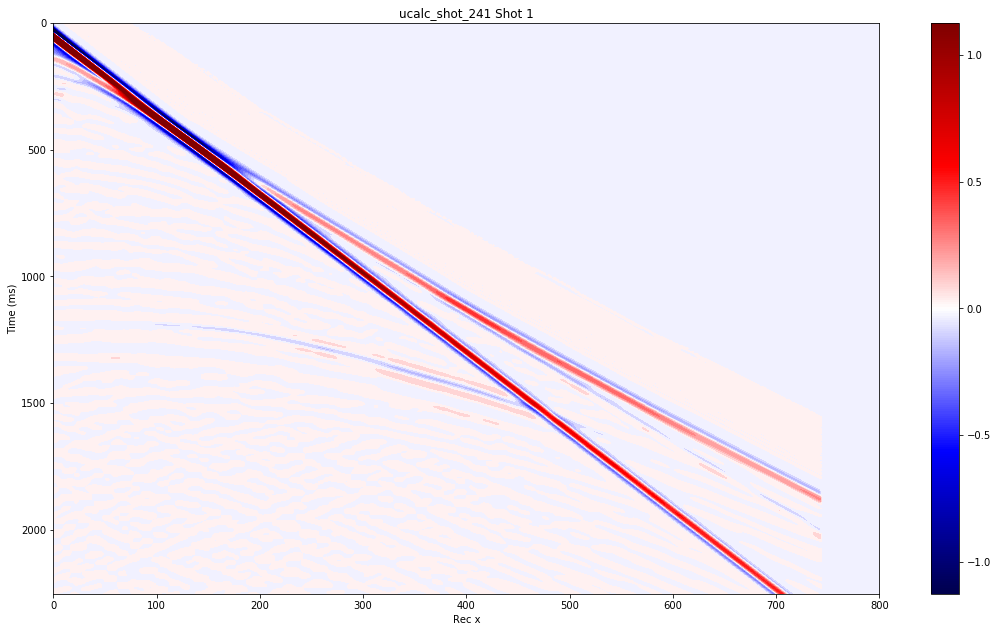

In [101]:
# Visualising the correspondent observed shot
shot = 1
val = 0.3 * np.max(np.abs(TRUESHOT_241.data[0]))
visual.amplitude(TRUESHOT_241, shot=shot, vmin=-val, vmax=val )

### The following PARBASE_2-6 are similar setups of PARBASE25, apart from trying to correct the boundary anomalies


2019-08-07 10:56:55.990147 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_2/PARBASE25_2-CP00130-Vp.sgy...
2019-08-07 10:56:55.992417 	 Reading model...
2019-08-07 10:56:56.000601 	 Successfully loaded model of size 201 x 661!

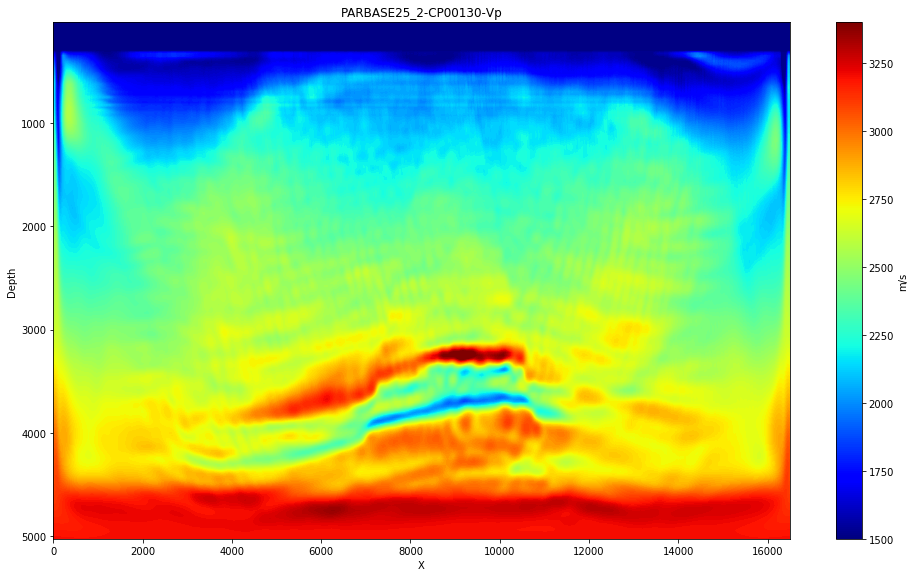

In [64]:
PARBASE25_2 = tools.load(path+"PARBASE25_2/PARBASE25_2-CP00130-Vp.sgy", model=True)
visual.vpmodel(PARBASE25_2, vmin=1500, vmax=3400)


2019-08-07 10:58:39.112436 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_3/PARBASE25_3-CP00010-Vp.sgy...
2019-08-07 10:58:39.114564 	 Reading model...
2019-08-07 10:58:39.122395 	 Successfully loaded model of size 201 x 661!

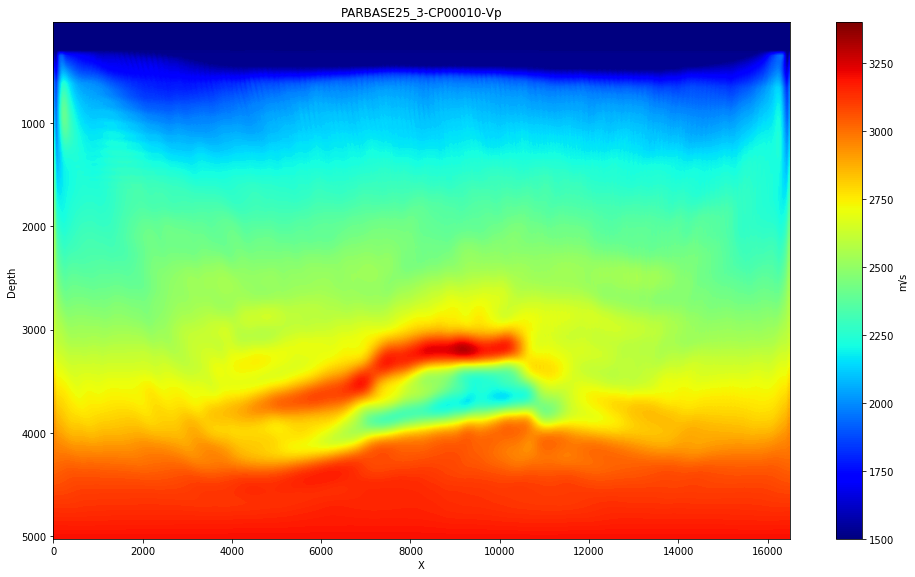

In [65]:
PARBASE25_3 = tools.load(path+"PARBASE25_3/PARBASE25_3-CP00010-Vp.sgy", model=True)
visual.vpmodel(PARBASE25_3, vmin=1500, vmax=3400)


2019-08-07 11:00:21.050422 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_4/PARBASE25_4-CP00130-Vp.sgy...
2019-08-07 11:00:21.051940 	 Reading model...
2019-08-07 11:00:21.061471 	 Successfully loaded model of size 201 x 661!

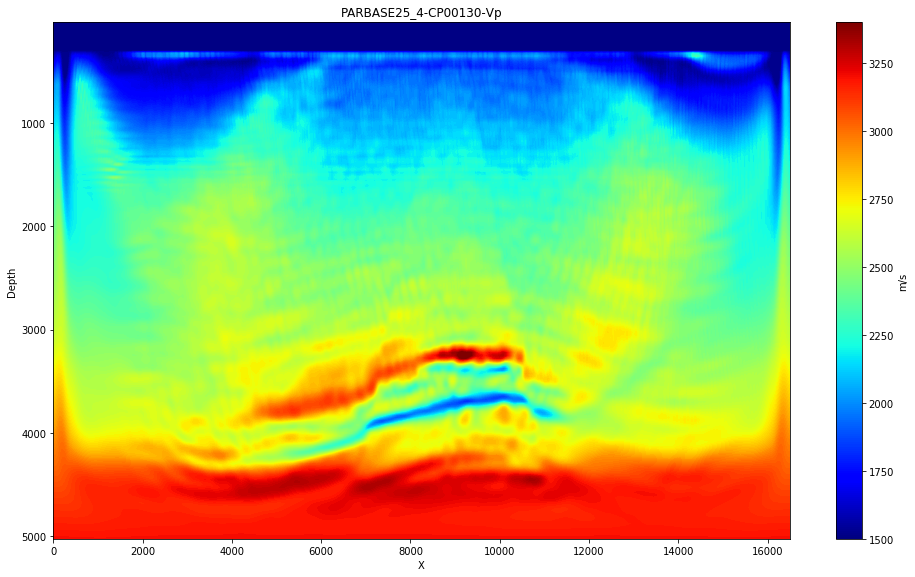

In [66]:
PARBASE25_4 = tools.load(path+"PARBASE25_4/PARBASE25_4-CP00130-Vp.sgy", model=True)
visual.vpmodel(PARBASE25_4, vmin=1500, vmax=3400)


2019-08-07 11:07:14.163606 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_5/PARBASE25_5-CP00130-Vp.sgy...
2019-08-07 11:07:14.166859 	 Reading model...
2019-08-07 11:07:14.175986 	 Successfully loaded model of size 201 x 661!

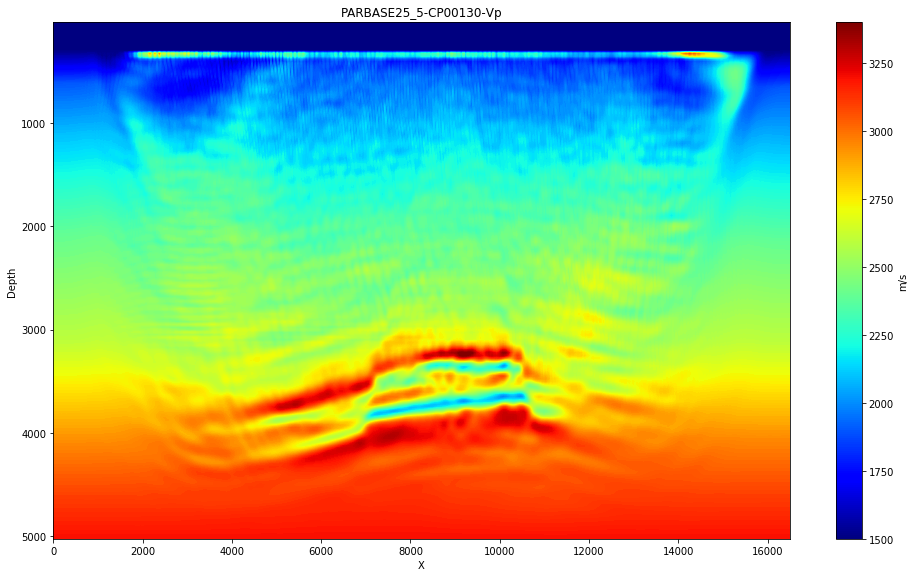

In [67]:
PARBASE25_5 = tools.load(path+"PARBASE25_5/PARBASE25_5-CP00130-Vp.sgy", model=True)
visual.vpmodel(PARBASE25_5, vmin=1500, vmax=3400)


2019-08-07 11:24:31.844378 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_6/PARBASE25_6-CP00130-Vp.sgy...
2019-08-07 11:24:31.845732 	 Reading model...
2019-08-07 11:24:31.854540 	 Successfully loaded model of size 201 x 661!

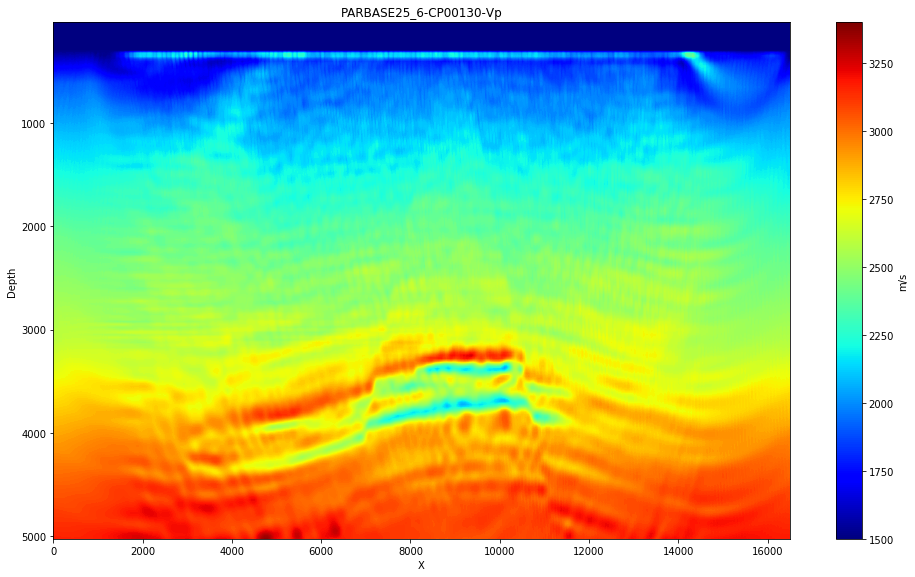

In [94]:
PARBASE25_6 = tools.load(path+"PARBASE25_6/PARBASE25_6-CP00130-Vp.sgy", model=True)
visual.vpmodel(PARBASE25_6, vmin=1500, vmax=3400)

(201,)


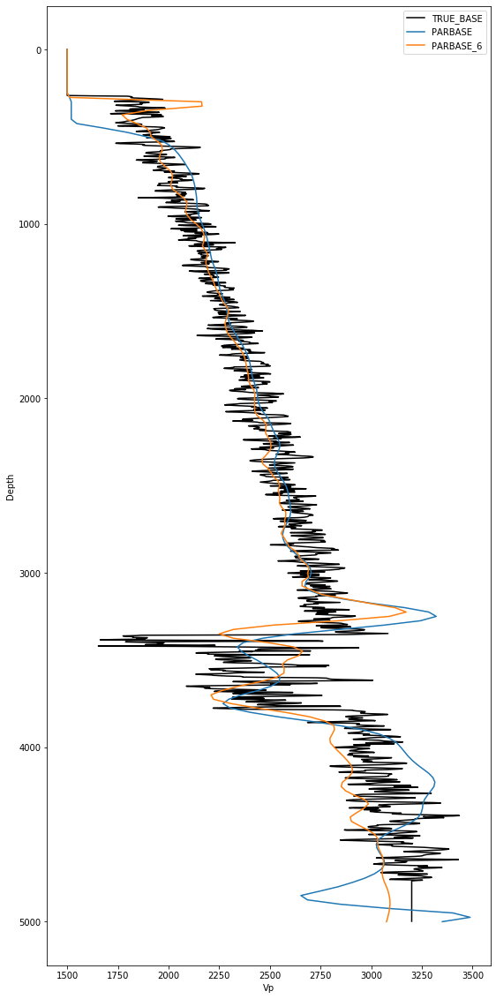

In [98]:
x_list = [9000]
w  = visual.vpwell(PARBASE25, pos_x=x_list, plot=False)[0]
w2 = visual.vpwell(PARBASE25_2, pos_x=x_list, plot=False)[0]
w3 = visual.vpwell(PARBASE25_3, pos_x=x_list, plot=False)[0]
w4 = visual.vpwell(PARBASE25_4, pos_x=x_list, plot=False)[0]
w5 = visual.vpwell(PARBASE25_5, pos_x=x_list, plot=False)[0]
w6 = visual.vpwell(PARBASE25_6, pos_x=x_list, plot=False)[0]
wb = visual.vpwell(TRUE_BASE, pos_x=x_list, plot=False)[0]
print(w.shape)

y =  np.arange(0, w.shape[0], 1) * PARBASE25.dx
yb =  np.arange(0, wb.shape[0], 1) * TRUE_BASE.dx

figure, ax = plt.subplots(1, 1)
figure.set_size_inches(9, 20)
ax.plot(wb, yb, 'k', label="TRUE_BASE")
ax.plot(w, y, label="PARBASE")
# ax.plot(w2, y, label="PARBASE_2")
# ax.plot(w3, y, label="PARBASE_3")
# ax.plot(w4, y, label="PARBASE_4")
# ax.plot(w5, y, label="PARBASE_5")
ax.plot(w6, y, label="PARBASE_6")
ax.set_ylabel("Depth")
ax.set_xlabel("Vp")
ax.invert_yaxis()
ax.legend(loc="best")
plt.show()

### Try to deal with the anomlous high velocity seabed by changing the minimum velocity from 1521 to 1500 . This is the lowest velocity required in the initial model for Fullwave3D updates. Velocities below this will be unchanged.



2019-08-07 11:40:47.691950 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_7/PARBASE25_7-CP00130-Vp.sgy...
2019-08-07 11:40:47.696602 	 Reading model...
2019-08-07 11:40:47.708264 	 Successfully loaded model of size 201 x 661!

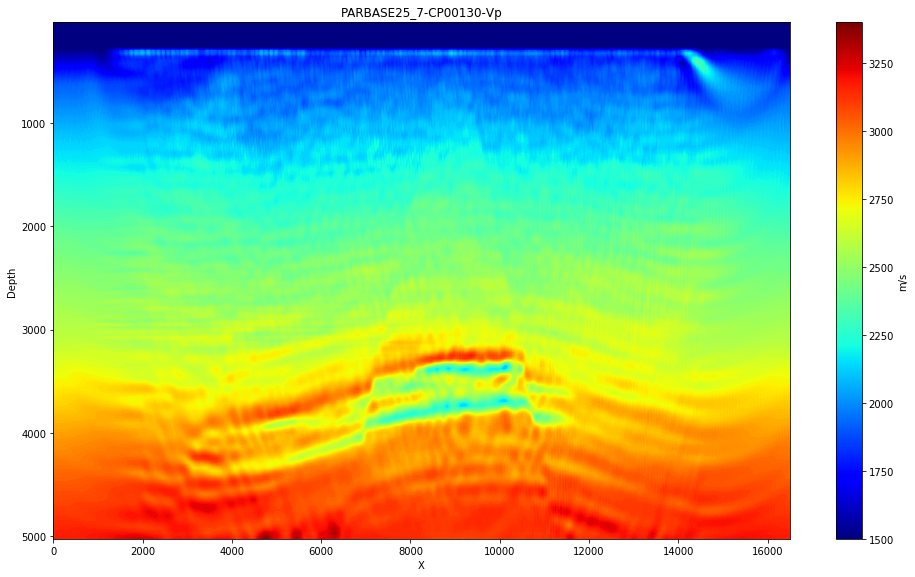

In [99]:
PARBASE25_7 = tools.load(path+"PARBASE25_7/PARBASE25_7-CP00130-Vp.sgy", model=True)
visual.vpmodel(PARBASE25_7, vmin=1500, vmax=3400)

(201,)


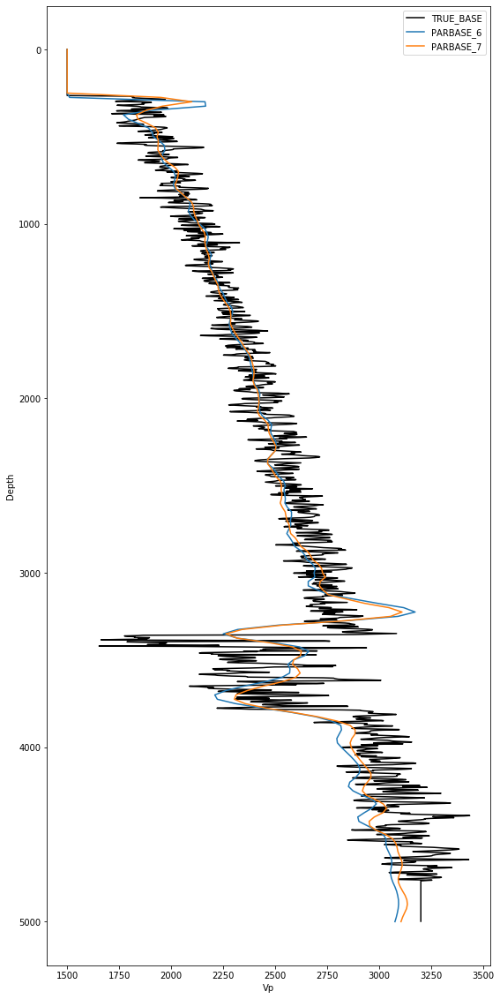

In [100]:
x_list = [9000]
w6 = visual.vpwell(PARBASE25_6, pos_x=x_list, plot=False)[0]
w7 = visual.vpwell(PARBASE25_7, pos_x=x_list, plot=False)[0]
wb = visual.vpwell(TRUE_BASE, pos_x=x_list, plot=False)[0]
print(w.shape)

y =  np.arange(0, w.shape[0], 1) * PARBASE25.dx
yb =  np.arange(0, wb.shape[0], 1) * TRUE_BASE.dx

figure, ax = plt.subplots(1, 1)
figure.set_size_inches(9, 20)
ax.plot(wb, yb, 'k', label="TRUE_BASE")
ax.plot(w6, y, label="PARBASE_6")
ax.plot(w7, y, label="PARBASE_7")
ax.set_ylabel("Depth")
ax.set_xlabel("Vp")
ax.invert_yaxis()
ax.legend(loc="best")
plt.show()

# TIMELAPSE WITH PARBASE25_7 SETUP


2019-08-07 12:41:10.318541 	 Opening file /geophysics2/dpelacani/PROJECTS/PARMON25_7/PARMON25_7-CP00130-Vp.sgy...
2019-08-07 12:41:10.322445 	 Reading model...
2019-08-07 12:41:10.331798 	 Successfully loaded model of size 201 x 661!

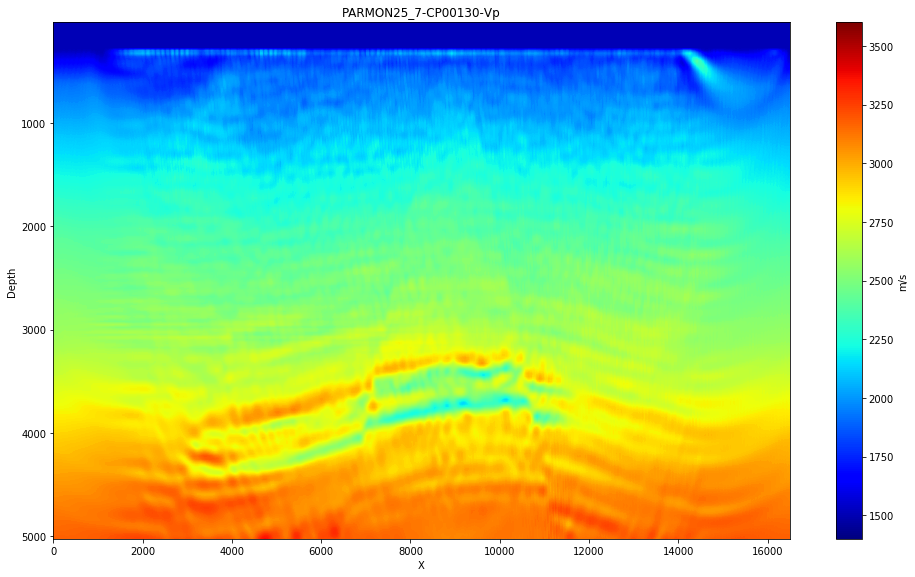

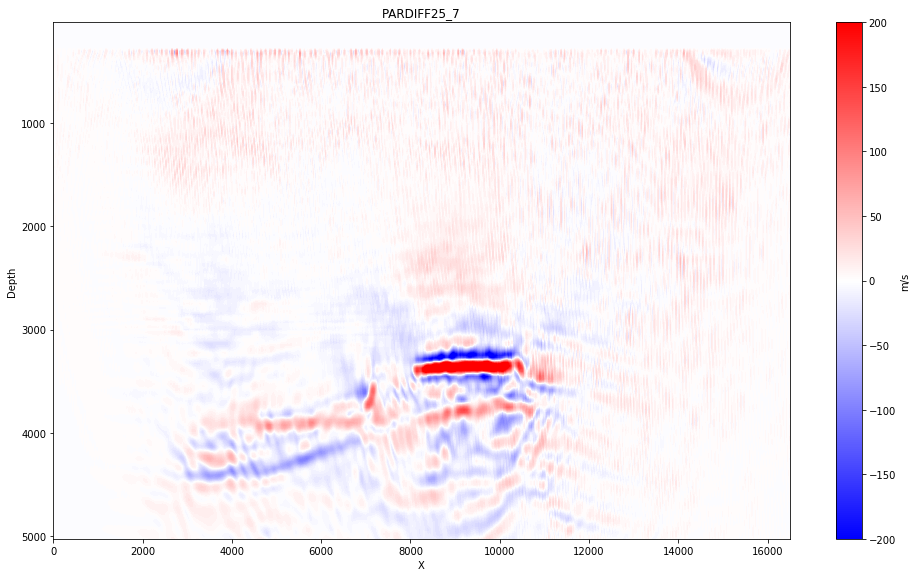

In [112]:
# PARDIFF25_7
# visualising the inverted monitor model
PARMON25_7 = tools.load(path+"PARMON25_7/PARMON25_7-CP00130-Vp.sgy", model=True, verbose=1)
visual.vpmodel(PARMON25_7, vmin=1400, vmax=3600)

# computing and visualising the difference
PARDIFF25_7= copy.deepcopy(PARBASE25_7)
PARDIFF25_7.name = "PARDIFF25_7"
PARDIFF25_7.data = PARMON25_7.data - PARBASE25_7.data
visual.vpmodel(PARDIFF25_7, cmap="bwr", vmin=-200, vmax=200)


2019-08-07 12:42:24.382042 	 Opening file /geophysics2/dpelacani/PROJECTS/SEQMON25_7/SEQMON25_7-CP00130-Vp.sgy...
2019-08-07 12:42:24.390109 	 Reading model...
2019-08-07 12:42:24.407630 	 Successfully loaded model of size 201 x 661!

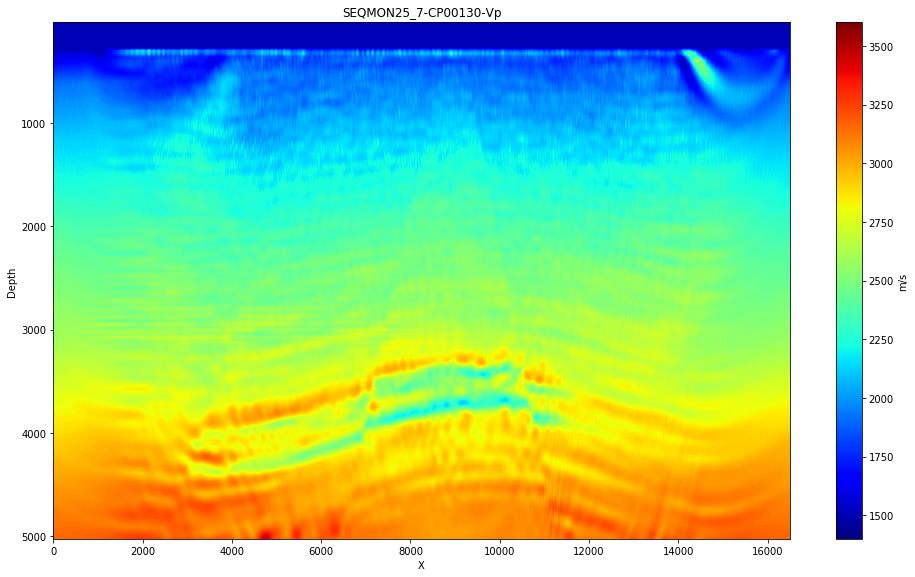

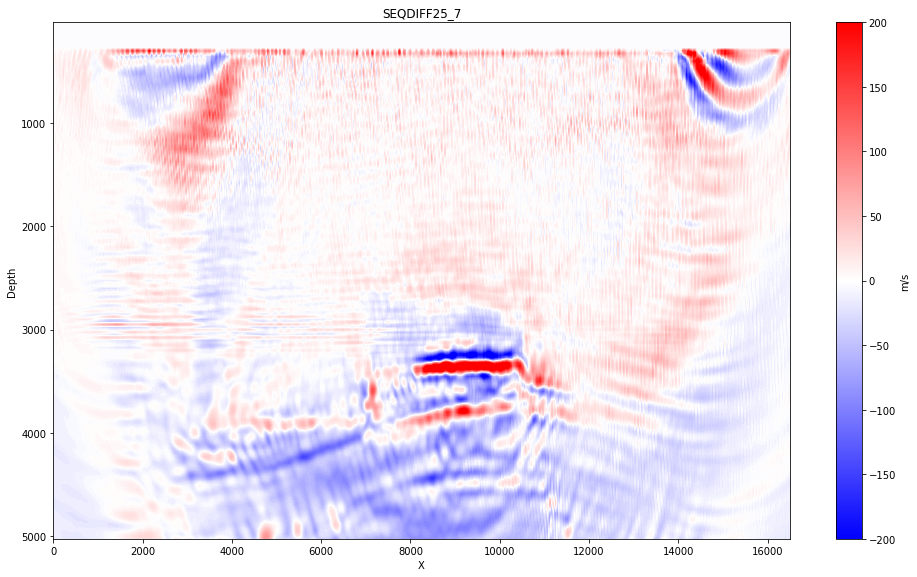

In [113]:
# SEQDIFF25_7
# visualising the inverted monitor model
SEQMON25_7 = tools.load(path+"SEQMON25_7/SEQMON25_7-CP00130-Vp.sgy", model=True, verbose=1)
visual.vpmodel(SEQMON25_7, vmin=1400, vmax=3600)

# computing and visualising the difference
SEQDIFF25_7= copy.deepcopy(PARBASE25_7)
SEQDIFF25_7.name = "SEQDIFF25_7"
SEQDIFF25_7.data = SEQMON25_7.data - PARBASE25_7.data
visual.vpmodel(SEQDIFF25_7, cmap="bwr", vmin=-200, vmax=200)


2019-08-07 12:43:00.131220 	 Opening file /geophysics2/dpelacani/PROJECTS/DDMON25_7/DDMON25_7-CP00130-Vp.sgy...
2019-08-07 12:43:00.138172 	 Reading model...
2019-08-07 12:43:00.146228 	 Successfully loaded model of size 201 x 661!

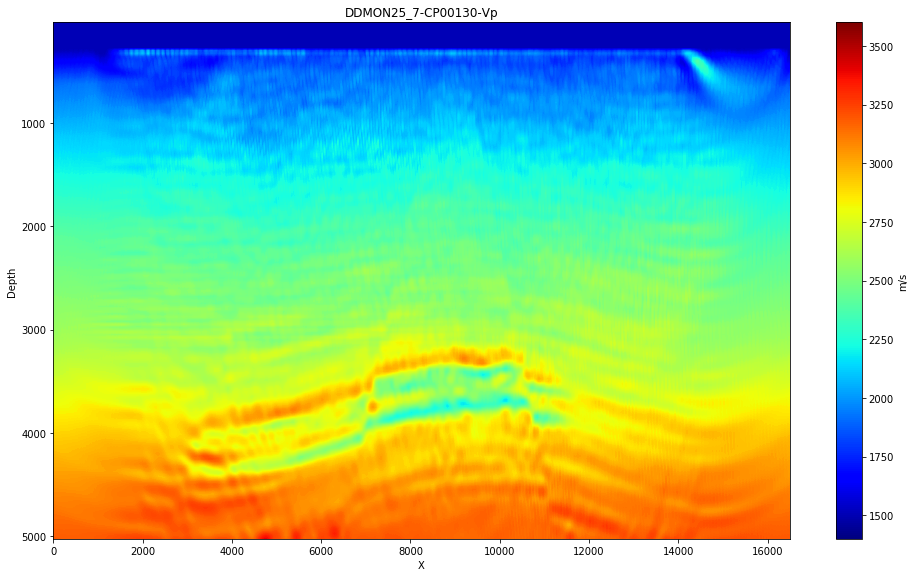

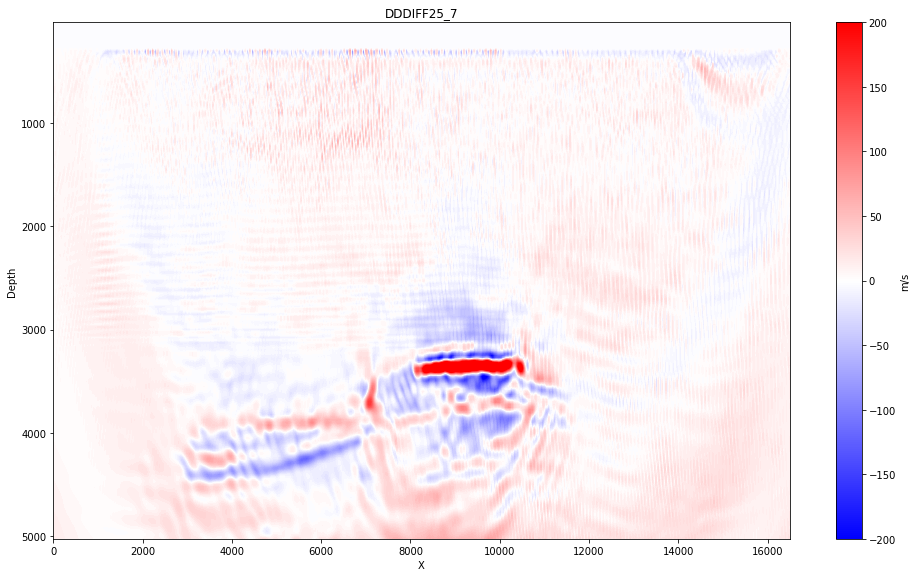

In [114]:
# DDDIFF25_7
# visualising the inverted monitor model
DDMON25_7 = tools.load(path+"DDMON25_7/DDMON25_7-CP00130-Vp.sgy", model=True, verbose=1)
visual.vpmodel(DDMON25_7, vmin=1400, vmax=3600)

# computing and visualising the difference
DDDIFF25_7= copy.deepcopy(PARBASE25_7)
DDDIFF25_7.name = "DDDIFF25_7"
DDDIFF25_7.data = DDMON25_7.data - PARBASE25_7.data
visual.vpmodel(DDDIFF25_7, cmap="bwr", vmin=-200, vmax=200)

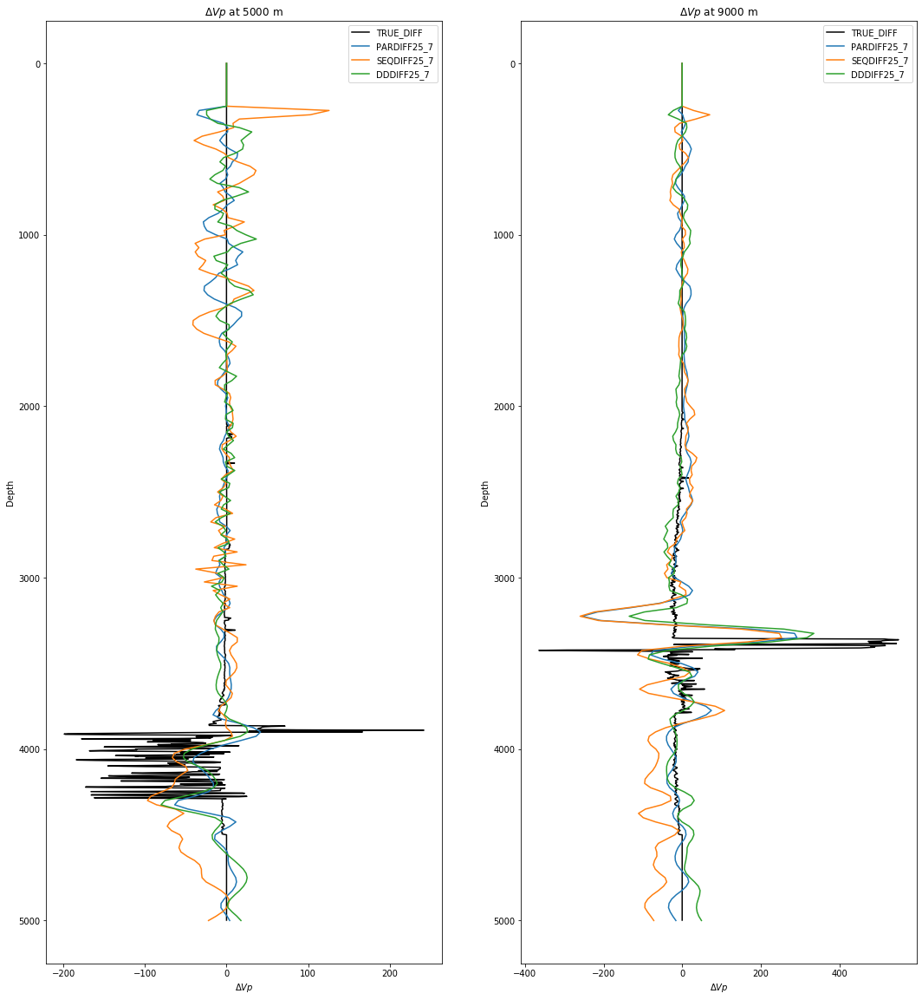

In [126]:
x_list = [5000, 9000]
pdiff7 = visual.vpwell(PARDIFF25_7, pos_x=x_list, plot=False)
sdiff7 = visual.vpwell(SEQDIFF25_7, pos_x=x_list, plot=False)
ddiff7 = visual.vpwell(DDDIFF25_7, pos_x=x_list, plot=False)
tdiff7 = visual.vpwell(TRUE_DIFF, pos_x=x_list, plot=False)


y =  np.arange(0, pdiff7[0].shape[0], 1) * PARDIFF25_7.dx
yb =  np.arange(0, tdiff7[0].shape[0], 1) * TRUE_DIFF.dx

figure, ax = plt.subplots(1, 2)
figure.set_size_inches(9*2, 20)
ax[0].plot(tdiff7[0], yb, 'k', label="TRUE_DIFF")
ax[0].plot(pdiff7[0], y, label="PARDIFF25_7")
ax[0].plot(sdiff7[0], y, label="SEQDIFF25_7")
ax[0].plot(ddiff7[0], y, label="DDDIFF25_7")
ax[0].set_title(r"$\Delta Vp$ at %g m"%x_list[0])
ax[0].set_ylabel("Depth")
ax[0].set_xlabel(r"$\Delta Vp$")
ax[0].invert_yaxis()
ax[0].legend(loc="best")

ax[1].plot(tdiff7[1], yb, 'k', label="TRUE_DIFF")
ax[1].plot(pdiff7[1], y, label="PARDIFF25_7")
ax[1].plot(sdiff7[1], y, label="SEQDIFF25_7")
ax[1].plot(ddiff7[1], y, label="DDDIFF25_7")
ax[1].set_title(r"$\Delta Vp$ at %g m"%x_list[1])
ax[1].set_ylabel("Depth")
ax[1].set_xlabel(r"$\Delta Vp$")
ax[1].invert_yaxis()
ax[1].legend(loc="best")
plt.show()

# Introducing FullwaveQC to analyse PARBASE25_7


2019-08-07 13:07:00.432569 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_7/PARBASE25_7-CP00130-Vp.sgy...
2019-08-07 13:07:00.436958 	 Reading model...
2019-08-07 13:07:00.450084 	 Successfully loaded model of size 201 x 661!

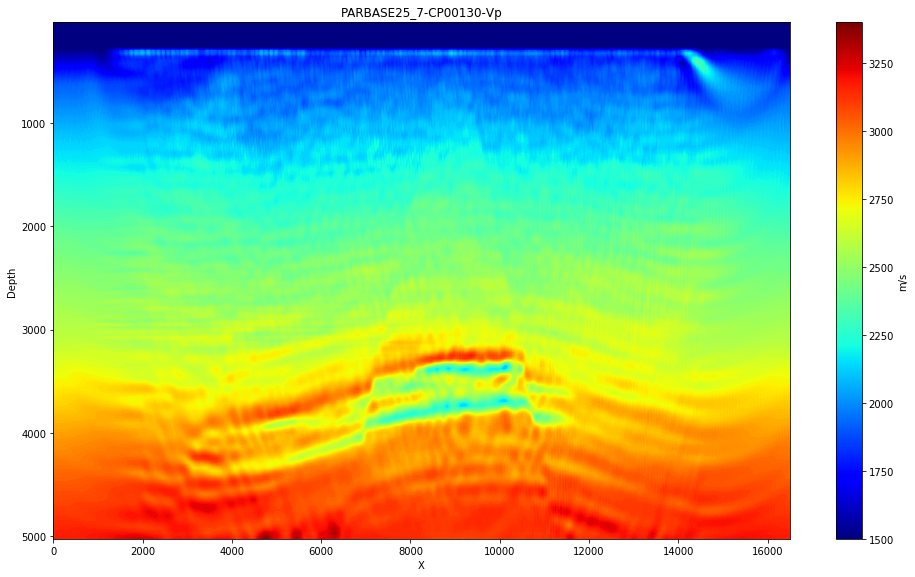

In [127]:
# The model
PARBASE25_7 = tools.load(path+"PARBASE25_7/PARBASE25_7-CP00130-Vp.sgy", model=True)
visual.vpmodel(PARBASE25_7, vmin=1500, vmax=3400)

In [131]:
# The model evolution
visual.animateinv(it_max=130, path=path+"PARBASE25_7/", project_name="PARBASE25_7")

/geophysics2/dpelacani/acse-9-independent-research-project-dekape/fullwaveqc/tools.py:171: UserWarning: Zero or negative model spacing. File might not have been loaded correctly.Check manually!
  warnings.warn("Zero or negative model spacing. File might not have been loaded correctly."


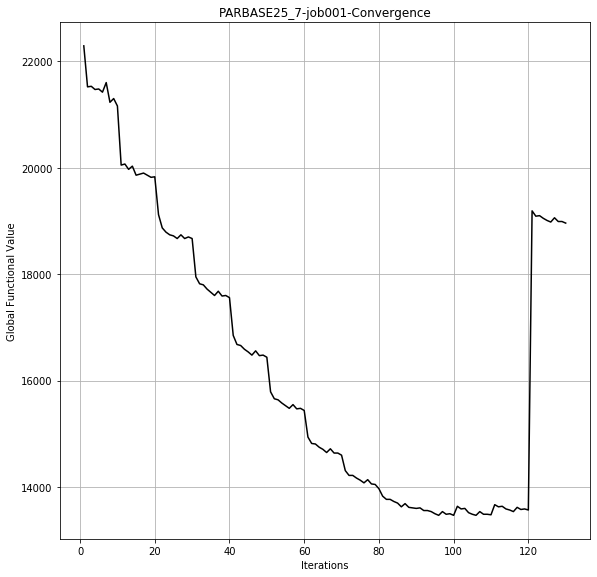

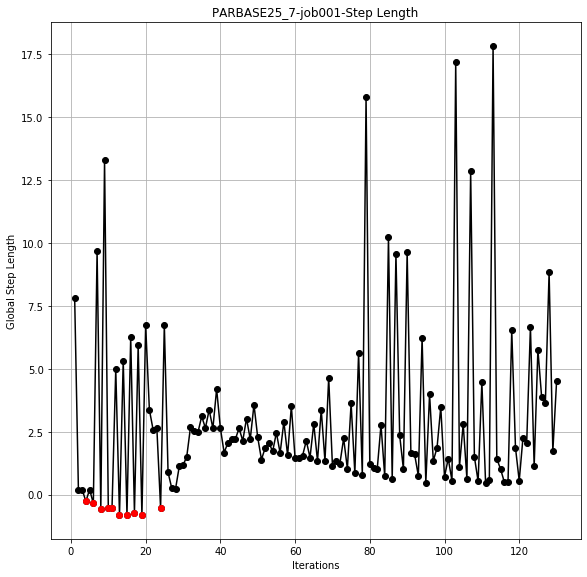

In [133]:
# The evolution of global functional and step length values
job_path = "/geophysics2/dpelacani/PROJECTS/PARBASE25_7/PARBASE25_7-job001.log"
_ = inversion.functional(job_path, plot=True)
_ = inversion.steplen(job_path, plot=True)

In [135]:
# Load observed data for comparison
PARBASE25_7OBS = tools.load(path+"PARBASE25_7/PARBASE25_7-Observed.sgy", model=False)


2019-08-07 13:45:20.063044 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_7/PARBASE25_7-Observed.sgy...
2019-08-07 13:45:20.082022 	 Loading data...
2019-08-07 13:46:11.959142 	 521 shots found. Loading headers...
2019-08-07 13:47:23.225547 	 322149 total traces read
2019-08-07 13:47:23.225908 	 Data loaded successfully

In [136]:
# Load synthetic shots over the final PARBASE25_7 model
PARBASE25FORALL_7 = tools.load(path+"PARBASE25FORALL_7/PARBASE25FORALL_7-Synthetic.sgy", model=False)


2019-08-07 13:48:32.127814 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25FORALL_7/PARBASE25FORALL_7-Synthetic.sgy...
2019-08-07 13:48:32.165285 	 Loading data...
2019-08-07 13:49:28.761940 	 521 shots found. Loading headers...
2019-08-07 13:50:42.492257 	 322149 total traces read
2019-08-07 13:50:42.492582 	 Data loaded successfully

In [138]:
# Normalising amplitude of synthetics with observed -- for easier visualisation
PARBASE25FORALL_7_NORM = tools.ampnorm(PARBASE25_7OBS, PARBASE25FORALL_7, ref_trace=0, verbose=1)

2019-08-07 13:51:27.412495 	 All shots normalised

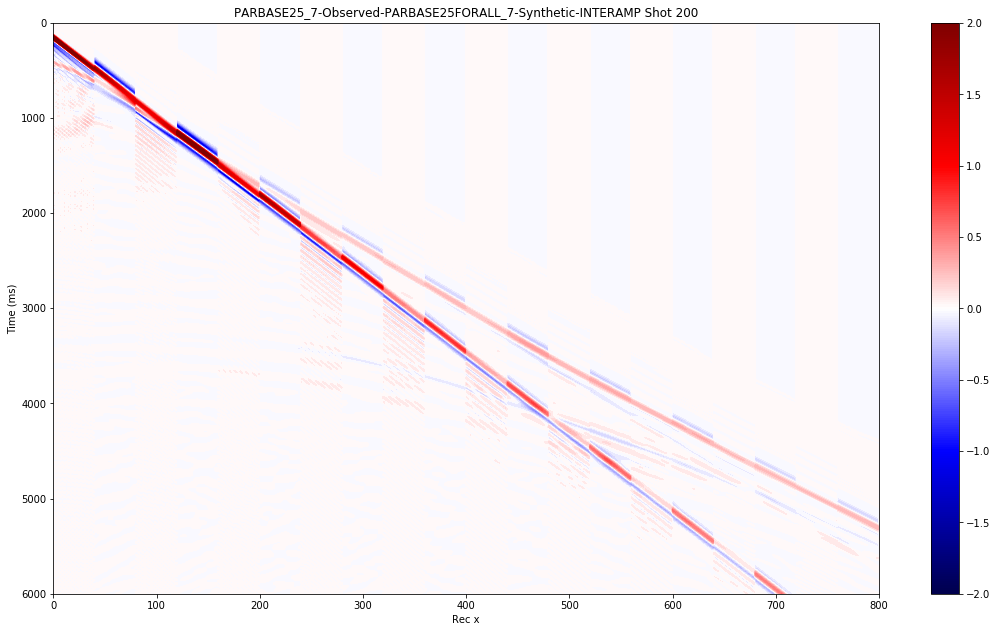

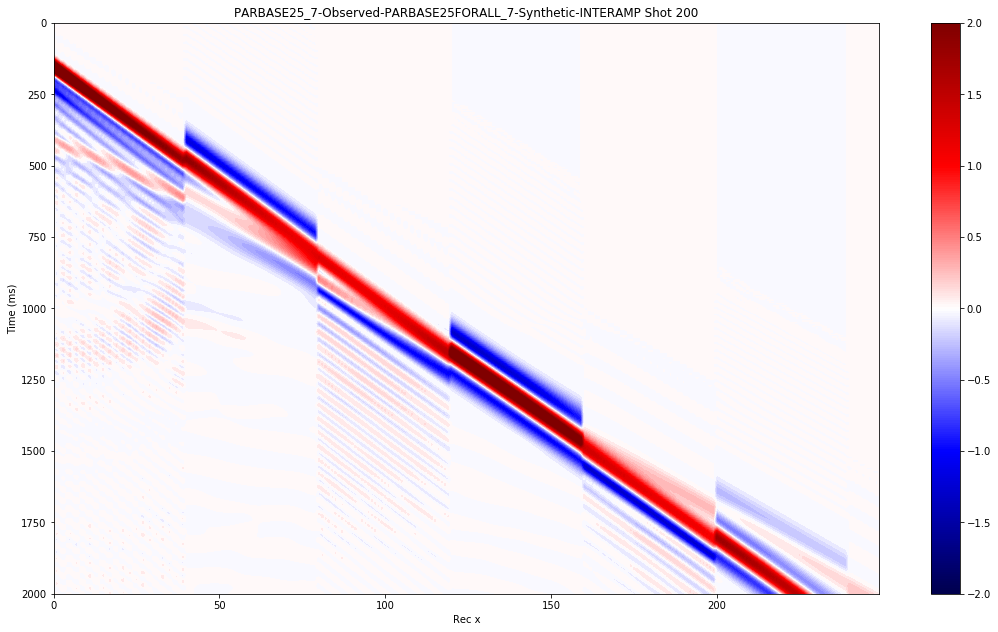

In [141]:
# Interleaving plots of predicted (synthetics) and observed data
visual.interamp(PARBASE25FORALL_7_NORM, PARBASE25_7OBS, shot=200, vmin=-2, vmax=2, n_blocks=20)

# Interleaving crop at early arrivals
visual.interamp(PARBASE25FORALL_7_NORM, PARBASE25_7OBS, shot=200, vmin=-2, vmax=2, n_blocks=20,
               wstart=0, wend=2000, xstart=0, xend=250)

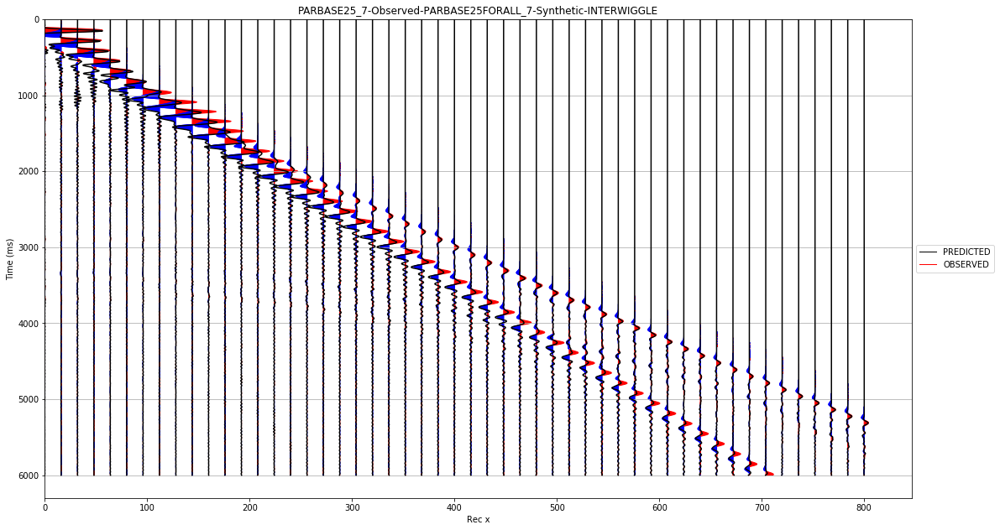

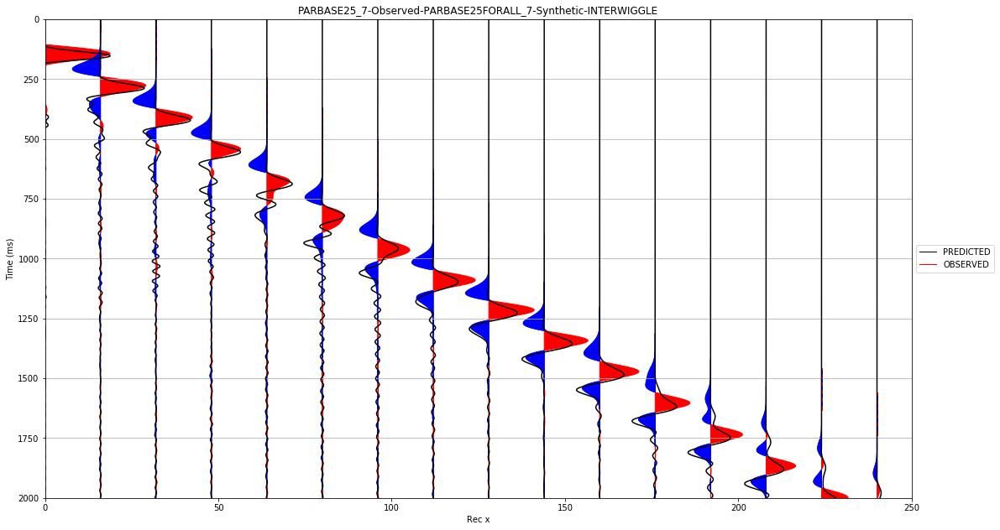

In [166]:
# Interleaving wiggles of predicted (synthetics) and observed data
visual.interwiggle(PARBASE25FORALL_7_NORM, PARBASE25_7OBS, shot=200, skip_trace=15, overlay=2, scale=15,
                   label1="PREDICTED", label2="OBSERVED")

# Interleaving crop at early arrivals
visual.interwiggle(PARBASE25FORALL_7_NORM, PARBASE25_7OBS, shot=200, skip_trace=15, overlay=2,
               wstart=0, wend=2000, xstart=0, xend=250, label1="PREDICTED", label2="OBSERVED")

2019-08-07 14:47:09.186143 	 Sampling Frequency = 500.0000 Hz2019-08-07 14:47:09.625654 	 Sampling Frequency = 500.0000 Hz

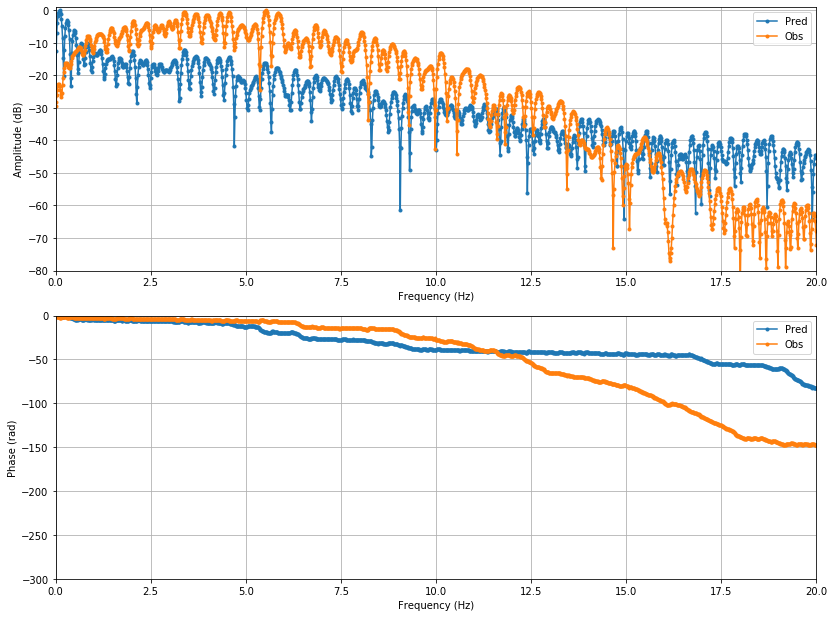

In [182]:
# Frequency density comparison between observed and predicted data
pred_spec = siganalysis.dataspec(PARBASE25FORALL_7_NORM, ms=True, shot=200, fmax=18, fft_smooth=10)
obs_spec = siganalysis.dataspec(PARBASE25_7OBS, ms=True, shot=200, fmax=18, fft_smooth=10)

figure, ax = plt.subplots(2, 1)
figure.set_size_inches(11.5, 8.5)

ax[0].plot(pred_spec[0], pred_spec[1], '.-', label="Pred")
ax[0].plot(obs_spec[0], obs_spec[1], '.-', label="Obs")

ax[0].grid()
ax[0].set(xlabel="Frequency (Hz)",
          ylabel="Amplitude (dB)")
ax[0].set_ylim(-80, 1)
ax[0].set_xlim(0, 20)

ax[1].plot(pred_spec[0], pred_spec[2], '.-', label="Pred")
ax[1].plot(obs_spec[0], obs_spec[2], '.-', label="Obs")
ax[1].set(xlabel="Frequency (Hz)",
          ylabel="Phase (rad)")
ax[1].grid()
ax[1].set_xlim(0, 20)
ax[1].set_ylim(-300, 0)
ax[1].legend(loc="best")
ax[0].legend(loc="best")
plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)


2019-08-07 14:10:39.511757 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_7/PARBASE25_7-RawSign.sgy...
2019-08-07 14:10:39.514263 	 Loading data...
2019-08-07 14:10:39.514936 	 1 shots found. Loading headers...
2019-08-07 14:10:39.515226 	 1 total traces read
2019-08-07 14:10:39.515334 	 Data loaded successfully
 [0.401] [1000]

2019-08-07 14:10:39.516598 	 Sampling Frequency = 1000.0000 Hz

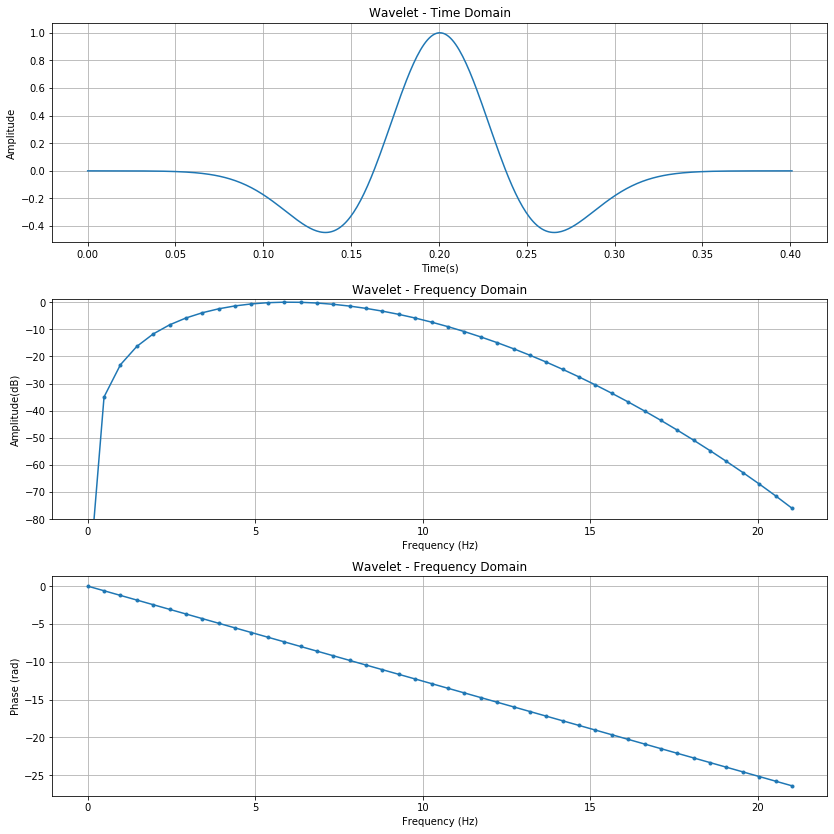

In [163]:
PARBASE25_7_WAVE = tools.load(path+"PARBASE25_7/PARBASE25_7-RawSign.sgy", model=False)
print("\n", PARBASE25_7_WAVE.attr("dt"), PARBASE25_7_WAVE.attr("samples"))

# correct the parameters that were not read properly
PARBASE25_7_WAVE.dt = [1.]
PARBASE25_7_WAVE.samples= [401]

wave_spec = siganalysis.wavespec(PARBASE25_7_WAVE, ms=True, fmax=18, plot=True, fft_smooth=5)


2019-08-07 14:10:42.378237 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_7/PARBASE25_7-Signature.sgy...
2019-08-07 14:10:42.379968 	 Loading data...
2019-08-07 14:10:42.423510 	 1 shots found. Loading headers...
2019-08-07 14:10:42.425877 	 521 total traces read
2019-08-07 14:10:42.426044 	 Data loaded successfully
 [3.001] [2000]

2019-08-07 14:10:42.427812 	 Sampling Frequency = 500.0000 Hz

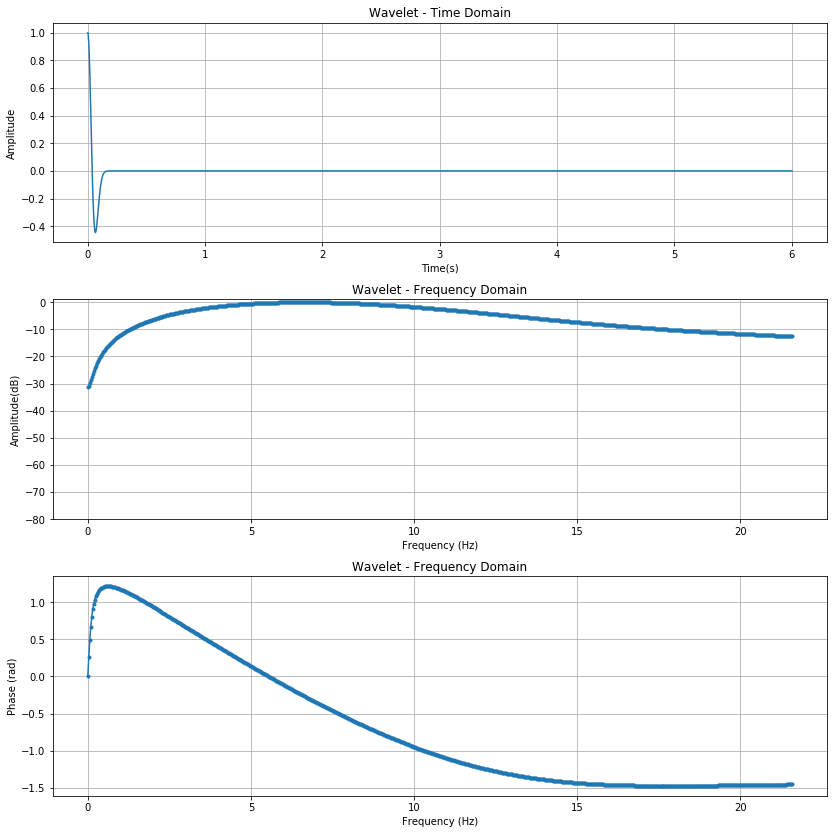

In [164]:
PARBASE25_7_SIG = tools.load(path+"PARBASE25_7/PARBASE25_7-Signature.sgy", model=False)
print("\n", PARBASE25_7_SIG.attr("dt"), PARBASE25_7_SIG.attr("samples"))

# correct the parameters that were not read properly
PARBASE25_7_SIG.dt = [2.]
PARBASE25_7_SIG.samples= [3001]

sig_spec = siganalysis.wavespec(PARBASE25_7_SIG, ms=True, fmax=18, plot=True, fft_smooth=5)

# PARBASE25_12


2019-08-07 14:31:34.524801 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_12/PARBASE25_12-CP00130-Vp.sgy...
2019-08-07 14:31:34.528702 	 Reading model...
2019-08-07 14:31:34.538412 	 Successfully loaded model of size 201 x 661!

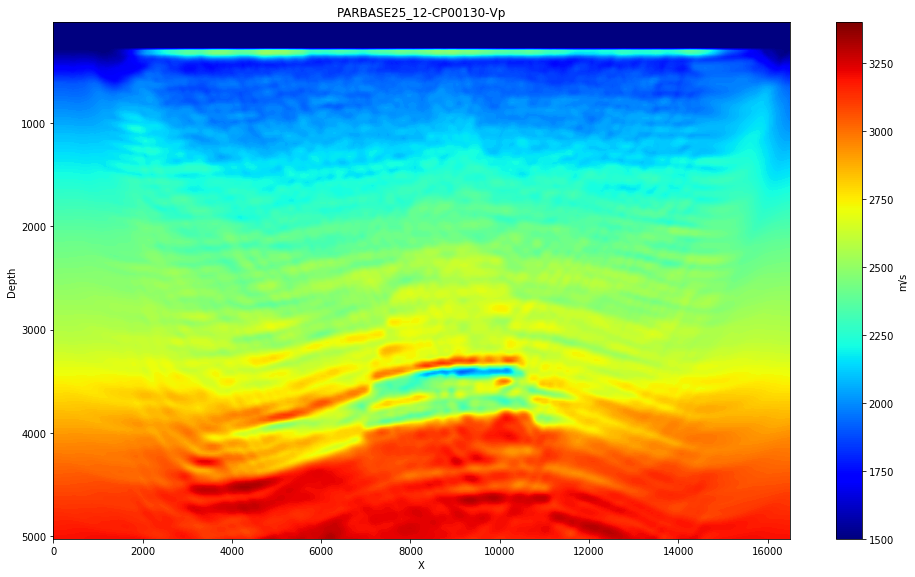

In [167]:
# The model
PARBASE25_12 = tools.load(path+"PARBASE25_12/PARBASE25_12-CP00130-Vp.sgy", model=True)
visual.vpmodel(PARBASE25_12, vmin=1500, vmax=3400)

In [168]:
# The model evolution
visual.animateinv(it_max=130, path=path+"PARBASE25_12/", project_name="PARBASE25_12")

/geophysics2/dpelacani/acse-9-independent-research-project-dekape/fullwaveqc/tools.py:171: UserWarning: Zero or negative model spacing. File might not have been loaded correctly.Check manually!
  warnings.warn("Zero or negative model spacing. File might not have been loaded correctly."


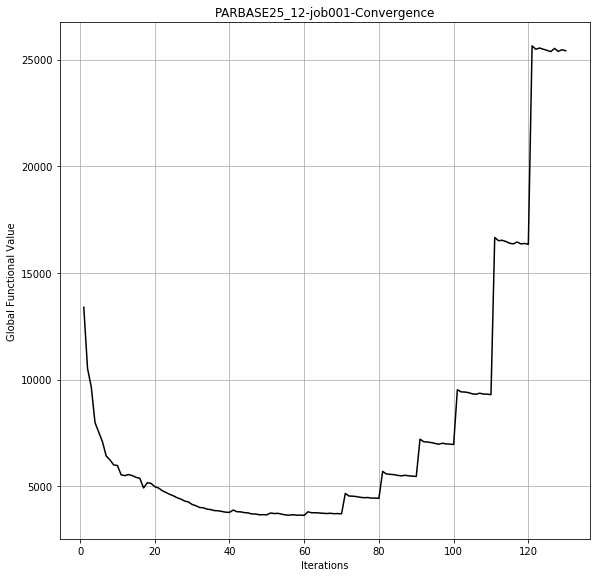

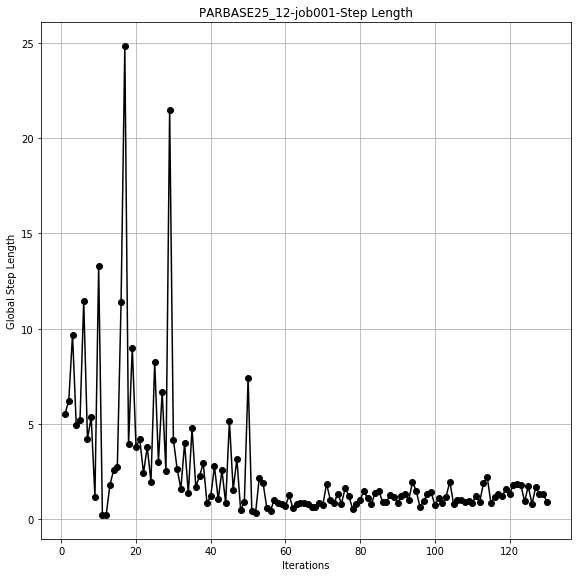

In [169]:
# The evolution of global functional and step length values
job_path = "/geophysics2/dpelacani/PROJECTS/PARBASE25_12/PARBASE25_12-job001.log"
_ = inversion.functional(job_path, plot=True)
_ = inversion.steplen(job_path, plot=True)

In [170]:
# Load observed data for comparison
PARBASE25_12OBS = tools.load(path+"PARBASE25_12/PARBASE25_12-Observed.sgy", model=False)


2019-08-07 14:37:27.668493 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_12/PARBASE25_12-Observed.sgy...
2019-08-07 14:37:27.673084 	 Loading data...
2019-08-07 14:37:48.497676 	 521 shots found. Loading headers...
2019-08-07 14:38:56.574009 	 322149 total traces read
2019-08-07 14:38:56.574355 	 Data loaded successfully

In [171]:
# Load synthetic shots over the final PARBASE25_7 model
PARBASE25FORALL_12 = tools.load(path+"PARBASE25FORALL_12/PARBASE25FORALL_12-Synthetic.sgy", model=False)


2019-08-07 14:39:03.923121 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25FORALL_12/PARBASE25FORALL_12-Synthetic.sgy...
2019-08-07 14:39:03.927091 	 Loading data...
2019-08-07 14:39:23.238348 	 521 shots found. Loading headers...
2019-08-07 14:40:31.845095 	 322149 total traces read
2019-08-07 14:40:31.845452 	 Data loaded successfully

In [172]:
# Normalising amplitude of synthetics with observed -- for easier visualisation
PARBASE25FORALL_12_NORM = tools.ampnorm(PARBASE25_12OBS, PARBASE25FORALL_12, ref_trace=0, verbose=1)

2019-08-07 14:40:41.836015 	 All shots normalised

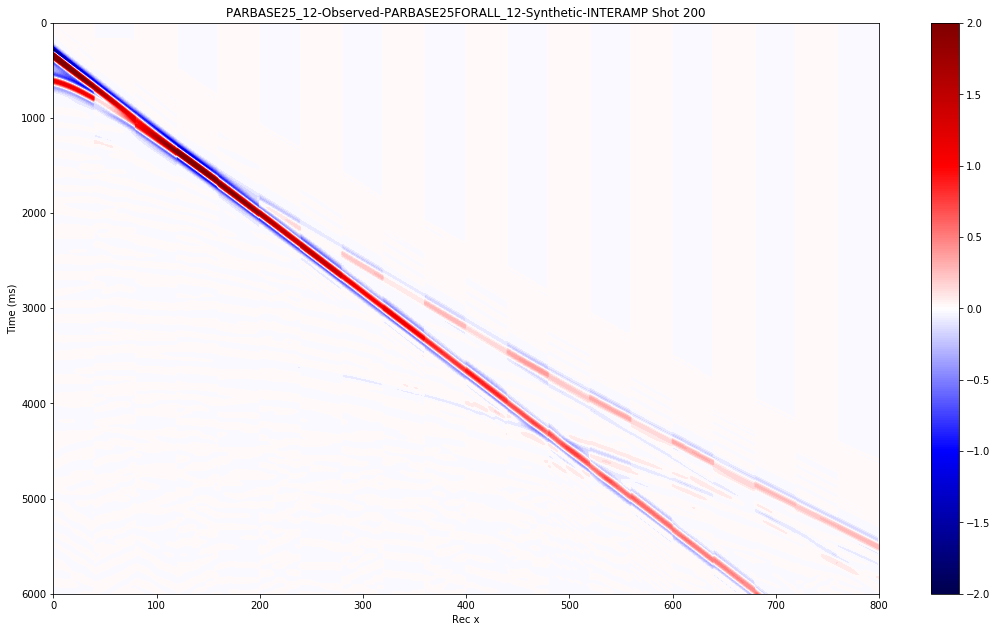

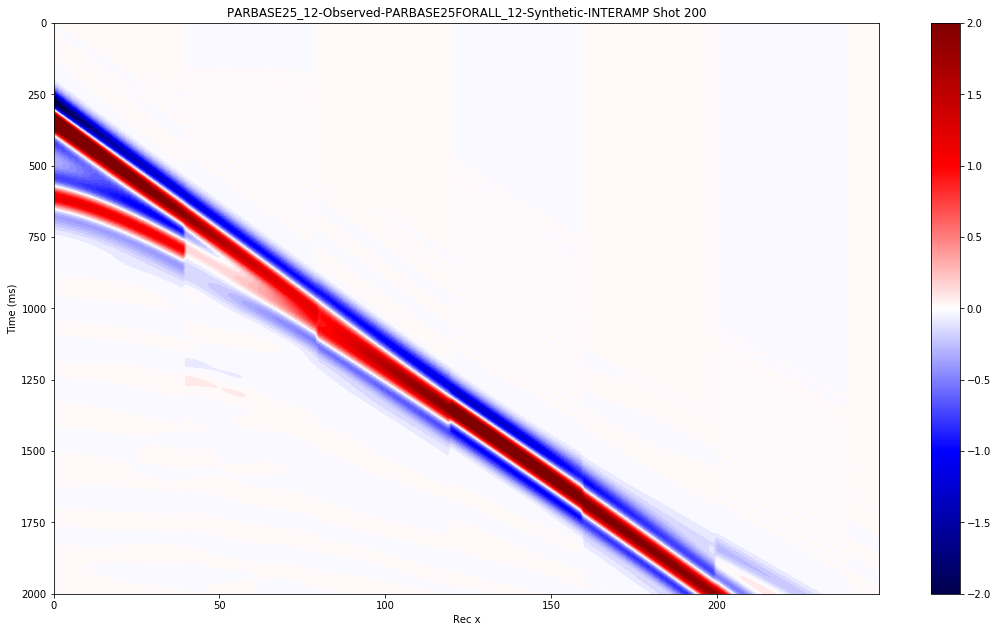

In [173]:
# Interleaving plots of predicted (synthetics) and observed data
visual.interamp(PARBASE25FORALL_12_NORM, PARBASE25_12OBS, shot=200, vmin=-2, vmax=2, n_blocks=20)

# Interleaving crop at early arrivals
visual.interamp(PARBASE25FORALL_12_NORM, PARBASE25_12OBS, shot=200, vmin=-2, vmax=2, n_blocks=20,
               wstart=0, wend=2000, xstart=0, xend=250)

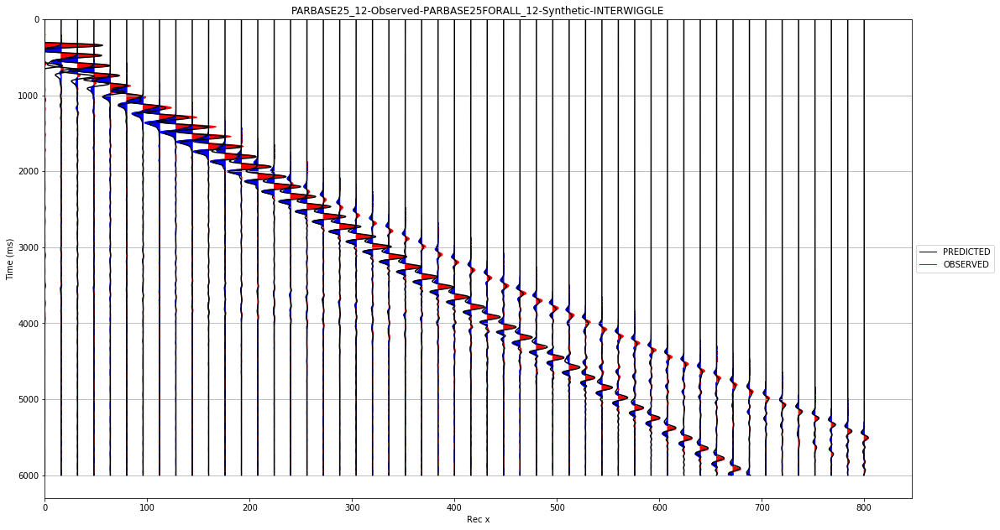

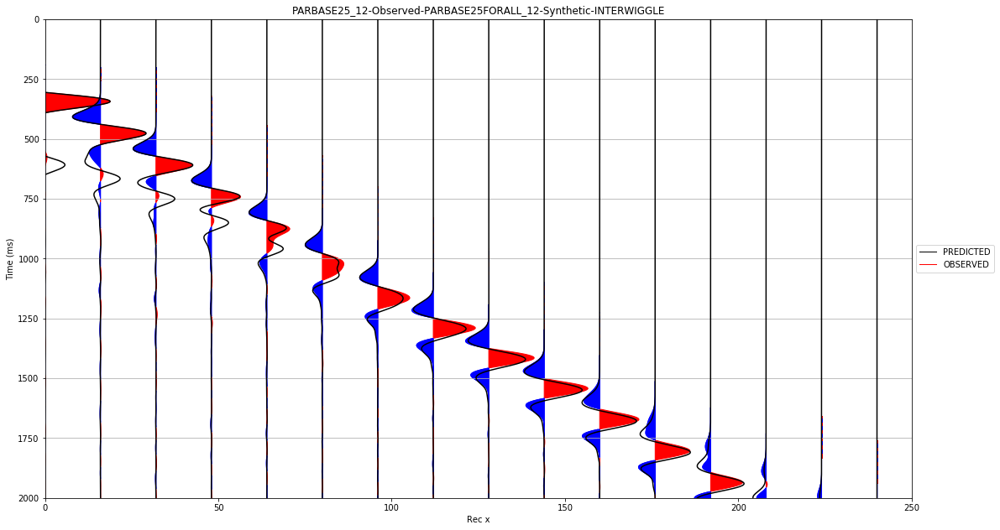

In [175]:
# Interleaving wiggles of predicted (synthetics) and observed data
visual.interwiggle(PARBASE25FORALL_12_NORM, PARBASE25_12OBS, shot=200, skip_trace=15, overlay=2, scale=15,
                   label1="PREDICTED", label2="OBSERVED")

# Interleaving crop at early arrivals
visual.interwiggle(PARBASE25FORALL_12_NORM, PARBASE25_12OBS, shot=200, skip_trace=15, overlay=2,
               wstart=0, wend=2000, xstart=0, xend=250, label1="PREDICTED", label2="OBSERVED")

2019-08-07 14:46:53.196525 	 Sampling Frequency = 500.0000 Hz2019-08-07 14:46:53.765758 	 Sampling Frequency = 500.0000 Hz

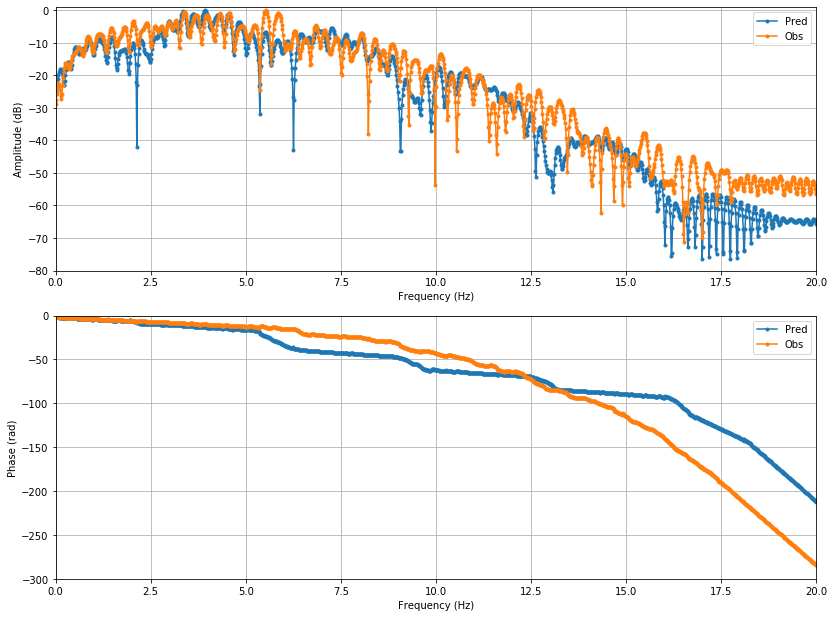

In [181]:
# Frequency density comparison between observed and predicted data
pred_spec12 = siganalysis.dataspec(PARBASE25FORALL_12_NORM, ms=True, shot=200, fmax=18, fft_smooth=10)
obs_spec12 = siganalysis.dataspec(PARBASE25_12OBS, ms=True, shot=200, fmax=18, fft_smooth=10)

figure, ax = plt.subplots(2, 1)
figure.set_size_inches(11.5, 8.5)

ax[0].plot(pred_spec12[0], pred_spec12[1], '.-', label="Pred")
ax[0].plot(obs_spec12[0], obs_spec12[1], '.-', label="Obs")

ax[0].grid()
ax[0].set(xlabel="Frequency (Hz)",
          ylabel="Amplitude (dB)")
ax[0].set_ylim(-80, 1)
ax[0].set_xlim(0, 20)

ax[1].plot(pred_spec12[0], pred_spec12[2], '.-', label="Pred")
ax[1].plot(obs_spec12[0], obs_spec12[2], '.-', label="Obs")
ax[1].set(xlabel="Frequency (Hz)",
          ylabel="Phase (rad)")
ax[1].grid()
ax[1].set_xlim(0, 20)
ax[1].set_ylim(-300, 0)

ax[1].legend(loc="best")
ax[0].legend(loc="best")
plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)


2019-08-07 14:48:12.148455 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_12/PARBASE25_12-RawSign.sgy...
2019-08-07 14:48:12.149726 	 Loading data...
2019-08-07 14:48:12.150193 	 1 shots found. Loading headers...
2019-08-07 14:48:12.150409 	 1 total traces read
2019-08-07 14:48:12.150522 	 Data loaded successfully
 [0.401] [1000]

2019-08-07 14:48:12.151413 	 Sampling Frequency = 1000.0000 Hz

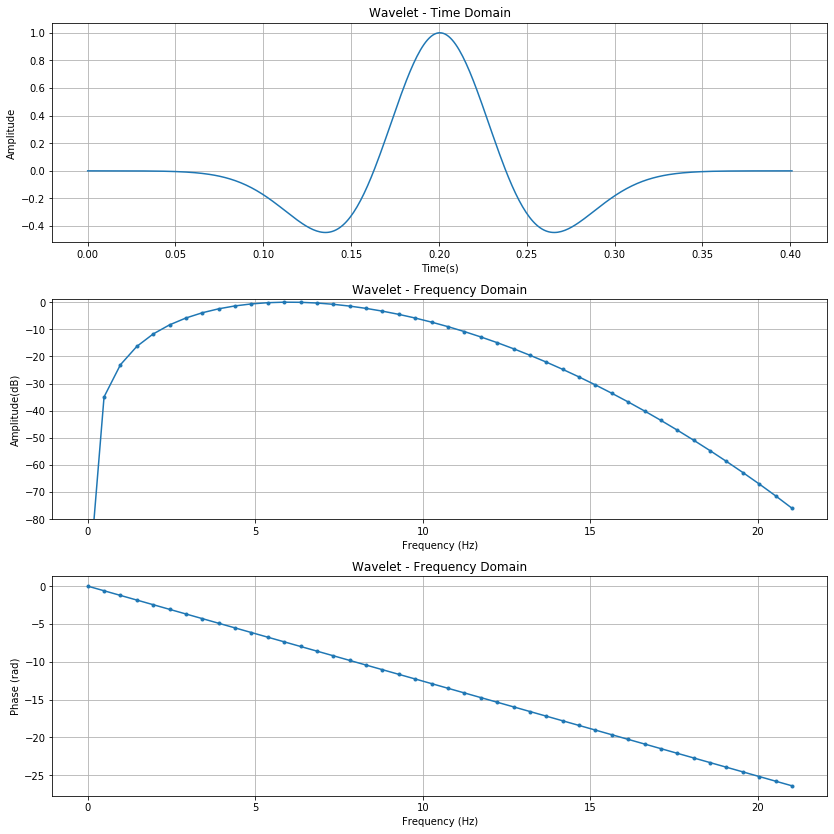

In [184]:
PARBASE25_12_WAVE = tools.load(path+"PARBASE25_12/PARBASE25_12-RawSign.sgy", model=False)
print("\n", PARBASE25_12_WAVE.attr("dt"), PARBASE25_12_WAVE.attr("samples"))

# correct the parameters that were not read properly
PARBASE25_12_WAVE.dt = [1.]
PARBASE25_12_WAVE.samples= [401]

wave_spec = siganalysis.wavespec(PARBASE25_12_WAVE, ms=True, fmax=18, plot=True, fft_smooth=5)


2019-08-07 14:48:31.542450 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_12/PARBASE25_12-Signature.sgy...
2019-08-07 14:48:31.545042 	 Loading data...
2019-08-07 14:48:31.604241 	 1 shots found. Loading headers...
2019-08-07 14:48:31.607530 	 521 total traces read
2019-08-07 14:48:31.607706 	 Data loaded successfully
 [3.001] [2000]

2019-08-07 14:48:31.608873 	 Sampling Frequency = 500.0000 Hz

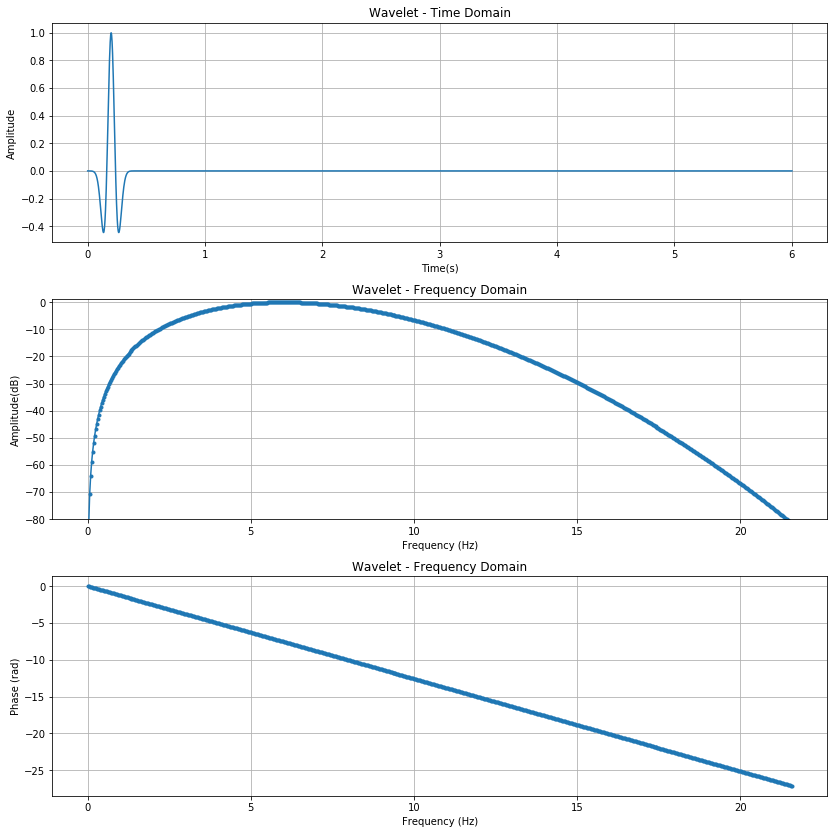

In [185]:
PARBASE25_12_SIG = tools.load(path+"PARBASE25_12/PARBASE25_12-Signature.sgy", model=False)
print("\n", PARBASE25_12_SIG.attr("dt"), PARBASE25_12_SIG.attr("samples"))

# correct the parameters that were not read properly
PARBASE25_12_SIG.dt = [2.]
PARBASE25_12_SIG.samples= [3001]

sig_spec = siganalysis.wavespec(PARBASE25_12_SIG, ms=True, fmax=18, plot=True, fft_smooth=5)

# TIMELAPSE WITH PARBASE25_12 SETUP


2019-08-07 14:57:44.281067 	 Opening file /geophysics2/dpelacani/PROJECTS/PARMON25_12/PARMON25_12-CP00130-Vp.sgy...
2019-08-07 14:57:44.282565 	 Reading model...
2019-08-07 14:57:44.291348 	 Successfully loaded model of size 201 x 661!

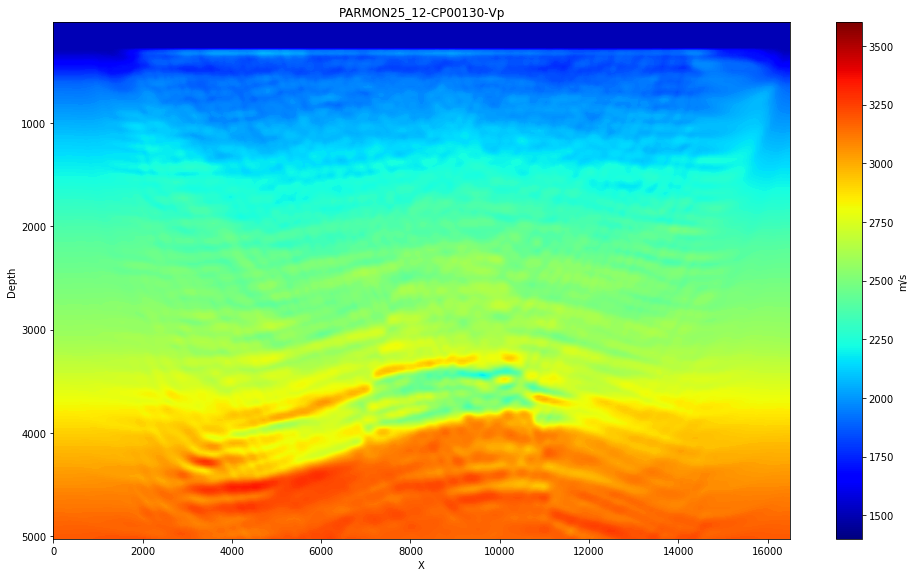

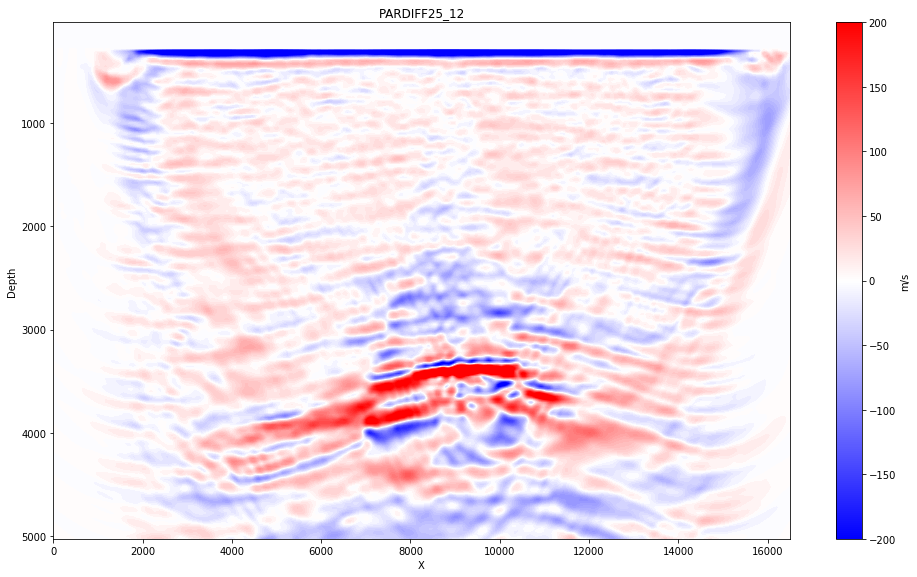

In [187]:
# PARDIFF25_12
# visualising the inverted monitor model
PARMON25_12 = tools.load(path+"PARMON25_12/PARMON25_12-CP00130-Vp.sgy", model=True, verbose=1)
visual.vpmodel(PARMON25_12, vmin=1400, vmax=3600)

# computing and visualising the difference
PARDIFF25_12= copy.deepcopy(PARBASE25_12)
PARDIFF25_12.name = "PARDIFF25_12"
PARDIFF25_12.data = PARMON25_12.data - PARBASE25_12.data
visual.vpmodel(PARDIFF25_12, cmap="bwr", vmin=-200, vmax=200)


2019-08-07 14:58:53.751875 	 Opening file /geophysics2/dpelacani/PROJECTS/SEQMON25_12/SEQMON25_12-CP00130-Vp.sgy...
2019-08-07 14:58:53.755740 	 Reading model...
2019-08-07 14:58:53.766028 	 Successfully loaded model of size 201 x 661!
2019-08-07 14:58:53.766788 	 Opening file /geophysics2/dpelacani/PROJECTS/SEQBASE25_12/SEQBASE25_12-CP00130-Vp.sgy...
2019-08-07 14:58:53.769531 	 Reading model...
2019-08-07 14:58:53.779375 	 Successfully loaded model of size 201 x 661!

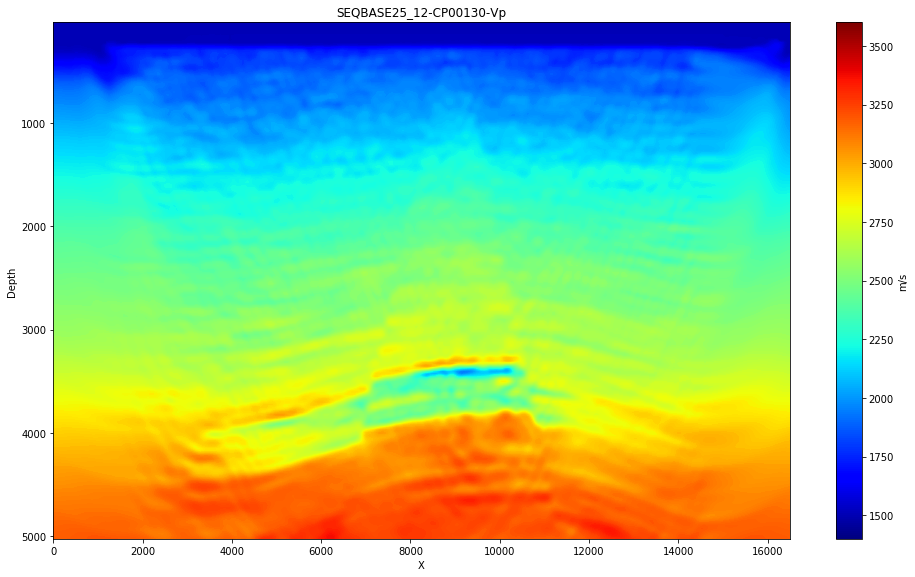

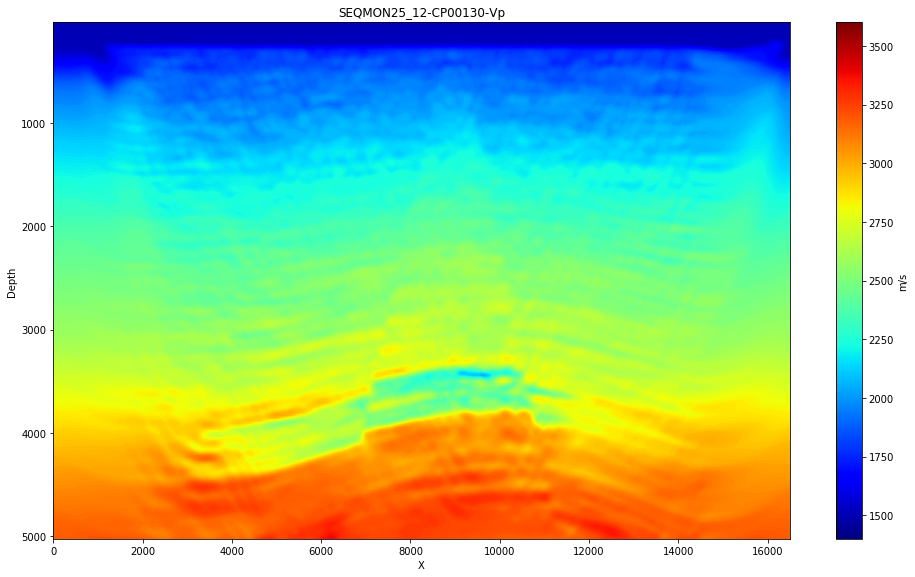

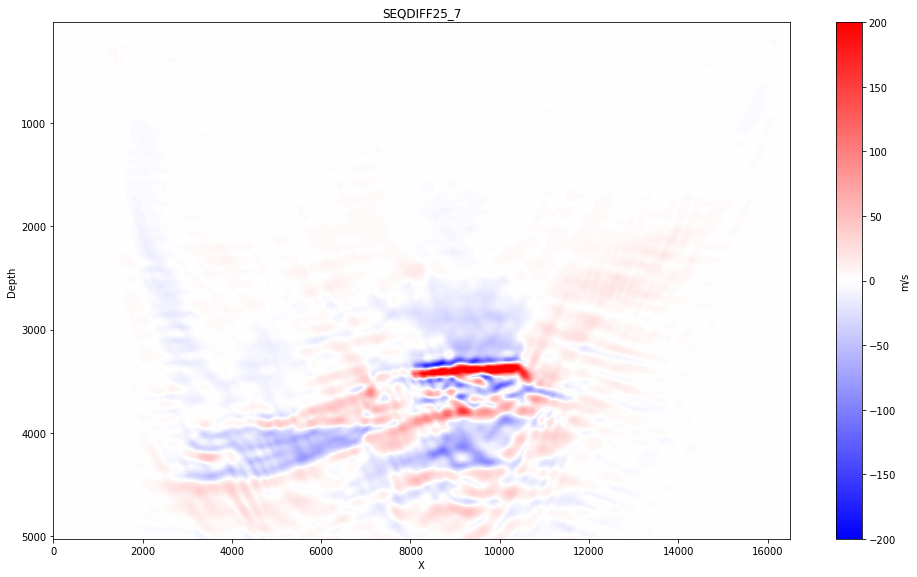

In [188]:
# SEQDIFF25_12
# visualising the inverted monitor model
SEQMON25_12 = tools.load(path+"SEQMON25_12/SEQMON25_12-CP00130-Vp.sgy", model=True, verbose=1)
SEQBASE25_12 = tools.load(path+"SEQBASE25_12/SEQBASE25_12-CP00130-Vp.sgy", model=True, verbose=1)
visual.vpmodel(SEQBASE25_12, vmin=1400, vmax=3600)
visual.vpmodel(SEQMON25_12, vmin=1400, vmax=3600)

# computing and visualising the difference
SEQDIFF25_12= copy.deepcopy(SEQBASE25_12)
SEQDIFF25_12.name = "SEQDIFF25_7"
SEQDIFF25_12.data = SEQMON25_12.data - SEQBASE25_12.data
visual.vpmodel(SEQDIFF25_12, cmap="bwr", vmin=-200, vmax=200)


2019-08-07 14:59:45.238441 	 Opening file /geophysics2/dpelacani/PROJECTS/DDMON25_12/DDMON25_12-CP00130-Vp.sgy...
2019-08-07 14:59:45.241450 	 Reading model...
2019-08-07 14:59:45.250335 	 Successfully loaded model of size 201 x 661!

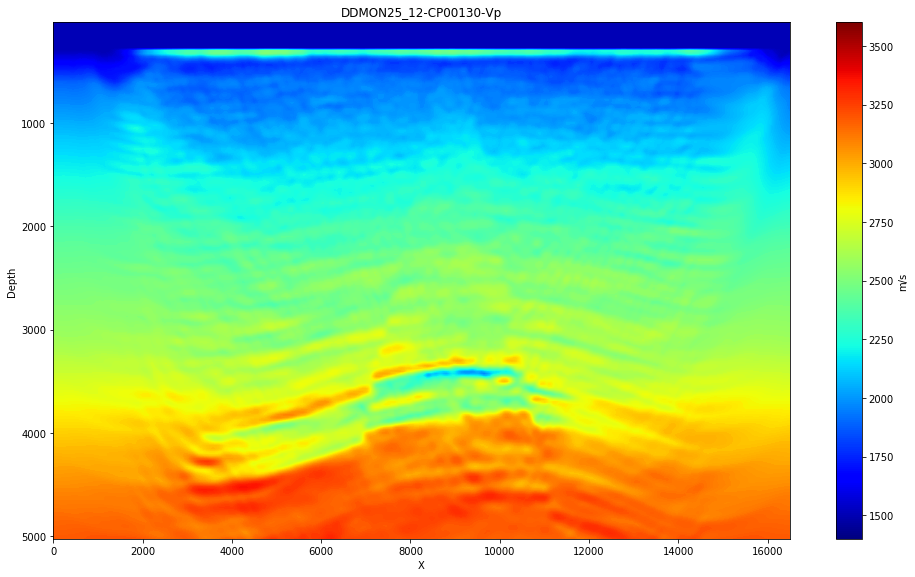

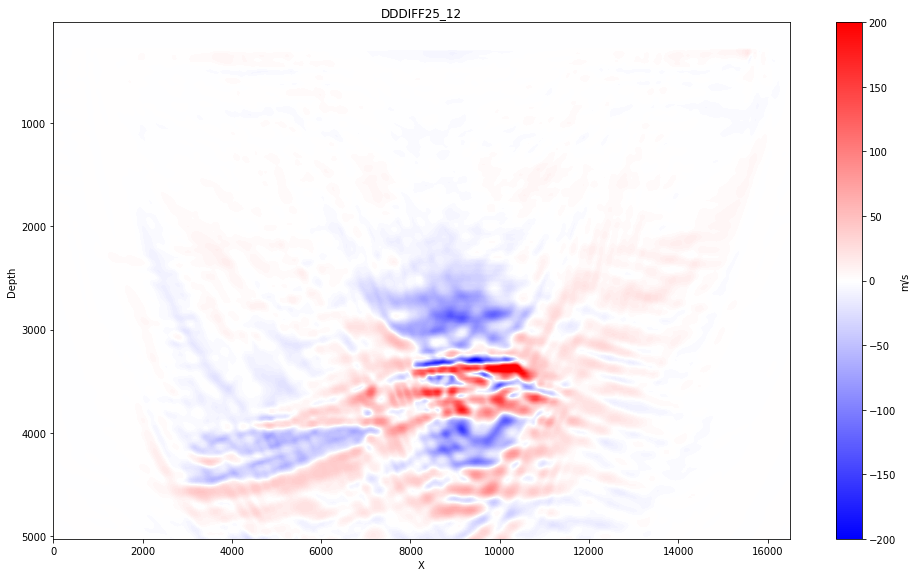

In [189]:
# DDDIFF25_12
# visualising the inverted monitor model
DDMON25_12 = tools.load(path+"DDMON25_12/DDMON25_12-CP00130-Vp.sgy", model=True, verbose=1)
visual.vpmodel(DDMON25_12, vmin=1400, vmax=3600)

# computing and visualising the difference
DDDIFF25_12= copy.deepcopy(PARBASE25_12)
DDDIFF25_12.name = "DDDIFF25_12"
DDDIFF25_12.data = DDMON25_12.data - PARBASE25_12.data
visual.vpmodel(DDDIFF25_12, cmap="bwr", vmin=-200, vmax=200)

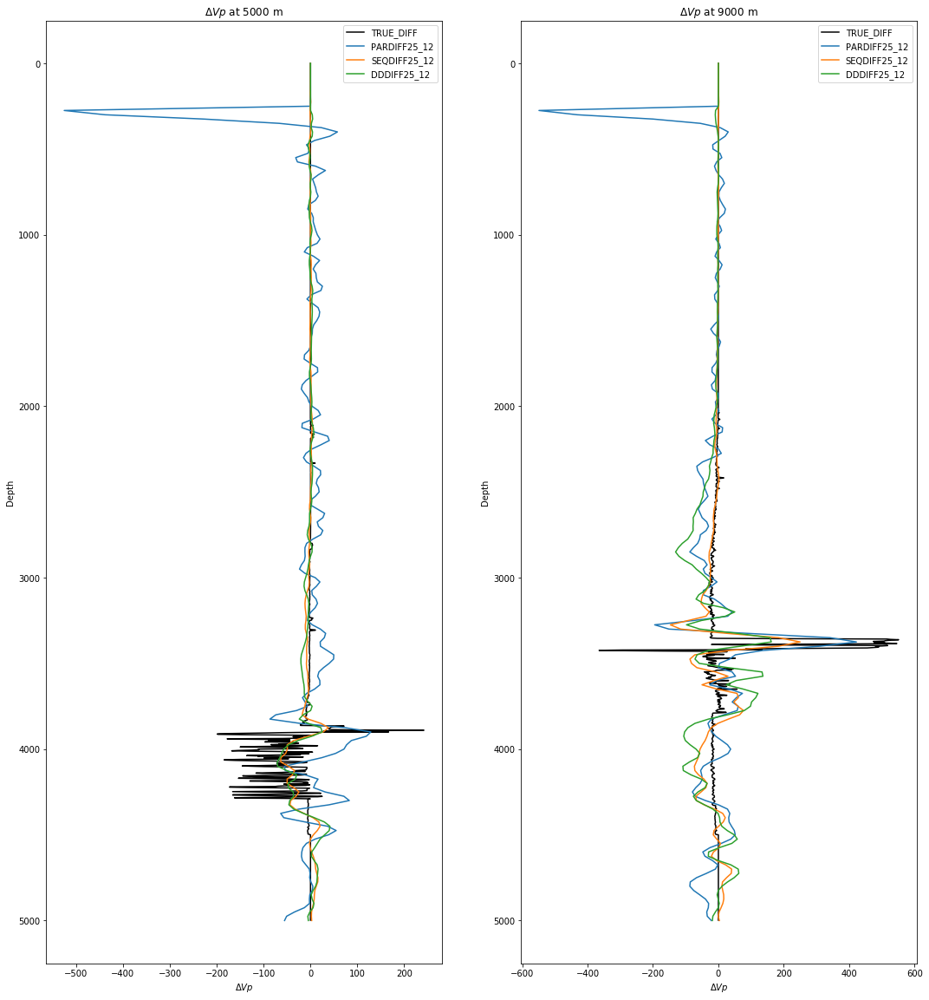

In [191]:
x_list = [5000, 9000]
pdiff12 = visual.vpwell(PARDIFF25_12, pos_x=x_list, plot=False)
sdiff12 = visual.vpwell(SEQDIFF25_12, pos_x=x_list, plot=False)
ddiff12 = visual.vpwell(DDDIFF25_12, pos_x=x_list, plot=False)
tdiff12 = visual.vpwell(TRUE_DIFF, pos_x=x_list, plot=False)


y =  np.arange(0, pdiff12[0].shape[0], 1) * PARDIFF25_12.dx
yb =  np.arange(0, tdiff12[0].shape[0], 1) * TRUE_DIFF.dx

figure, ax = plt.subplots(1, 2)
figure.set_size_inches(9*2, 20)
ax[0].plot(tdiff12[0], yb, 'k', label="TRUE_DIFF")
ax[0].plot(pdiff12[0], y, label="PARDIFF25_12")
ax[0].plot(sdiff12[0], y, label="SEQDIFF25_12")
ax[0].plot(ddiff12[0], y, label="DDDIFF25_12")
ax[0].set_title(r"$\Delta Vp$ at %g m"%x_list[0])
ax[0].set_ylabel("Depth")
ax[0].set_xlabel(r"$\Delta Vp$")
ax[0].invert_yaxis()
ax[0].legend(loc="best")

ax[1].plot(tdiff12[1], yb, 'k', label="TRUE_DIFF")
ax[1].plot(pdiff12[1], y, label="PARDIFF25_12")
ax[1].plot(sdiff12[1], y, label="SEQDIFF25_12")
ax[1].plot(ddiff12[1], y, label="DDDIFF25_12")
ax[1].set_title(r"$\Delta Vp$ at %g m"%x_list[1])
ax[1].set_ylabel("Depth")
ax[1].set_xlabel(r"$\Delta Vp$")
ax[1].invert_yaxis()
ax[1].legend(loc="best")
plt.show()

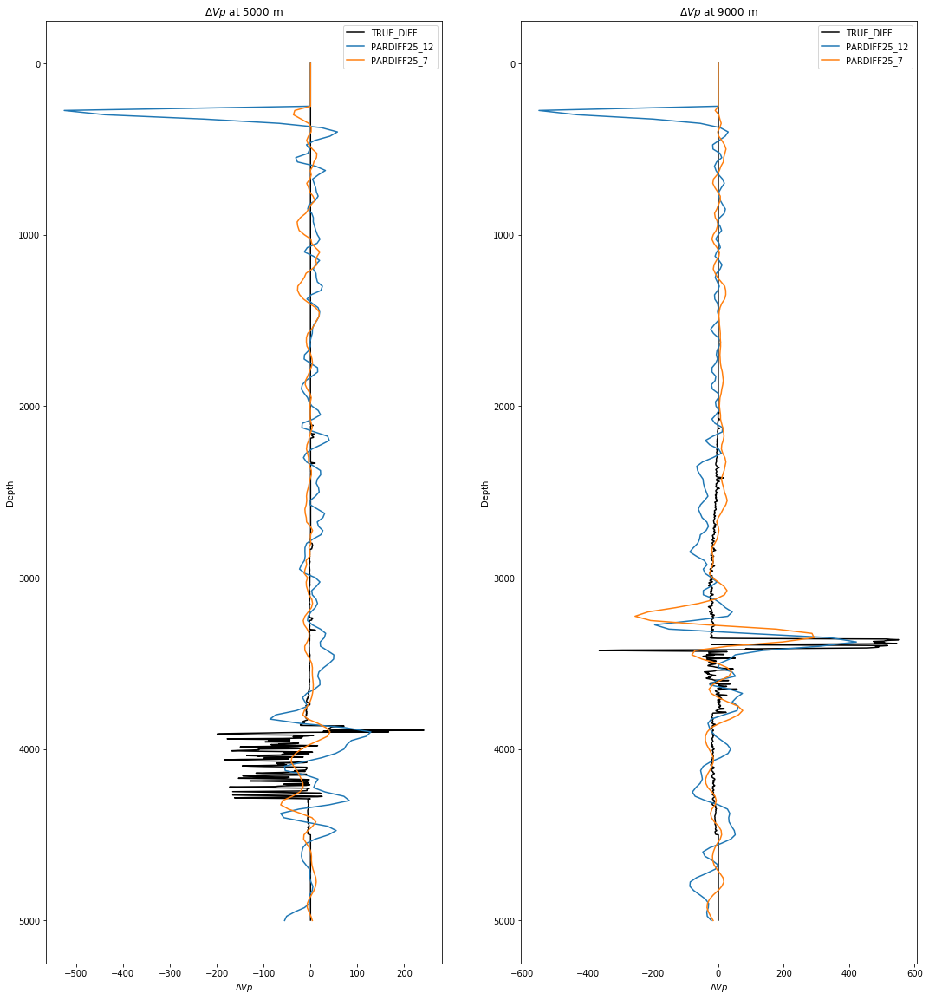

In [192]:
figure, ax = plt.subplots(1, 2)
figure.set_size_inches(9*2, 20)
ax[0].plot(tdiff12[0], yb, 'k', label="TRUE_DIFF")
ax[0].plot(pdiff12[0], y, label="PARDIFF25_12")
ax[0].plot(pdiff7[0], y, label="PARDIFF25_7")
ax[0].set_title(r"$\Delta Vp$ at %g m"%x_list[0])
ax[0].set_ylabel("Depth")
ax[0].set_xlabel(r"$\Delta Vp$")
ax[0].invert_yaxis()
ax[0].legend(loc="best")

ax[1].plot(tdiff12[1], yb, 'k', label="TRUE_DIFF")
ax[1].plot(pdiff12[1], y, label="PARDIFF25_12")
ax[1].plot(pdiff7[1], y, label="PARDIFF25_7")
ax[1].set_title(r"$\Delta Vp$ at %g m"%x_list[1])
ax[1].set_ylabel("Depth")
ax[1].set_xlabel(r"$\Delta Vp$")
ax[1].invert_yaxis()
ax[1].legend(loc="best")
plt.show()

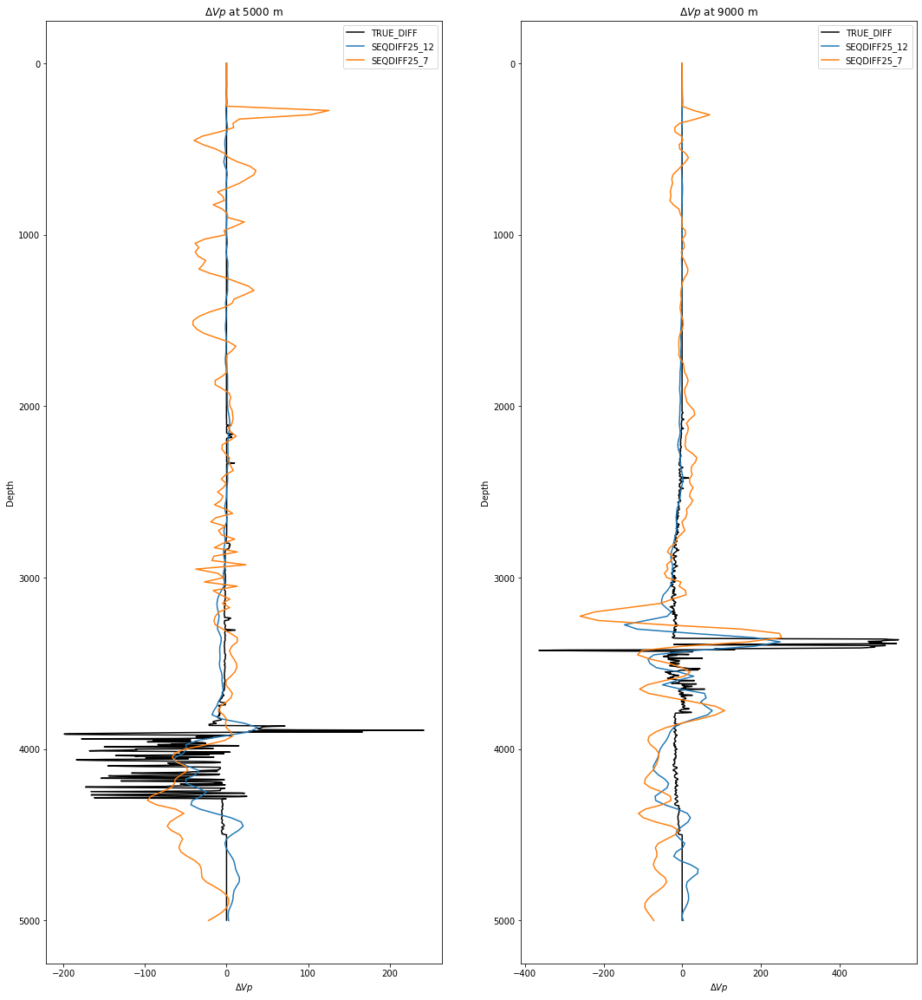

In [193]:
figure, ax = plt.subplots(1, 2)
figure.set_size_inches(9*2, 20)
ax[0].plot(tdiff12[0], yb, 'k', label="TRUE_DIFF")
ax[0].plot(sdiff12[0], y, label="SEQDIFF25_12")
ax[0].plot(sdiff7[0], y, label="SEQDIFF25_7")
ax[0].set_title(r"$\Delta Vp$ at %g m"%x_list[0])
ax[0].set_ylabel("Depth")
ax[0].set_xlabel(r"$\Delta Vp$")
ax[0].invert_yaxis()
ax[0].legend(loc="best")

ax[1].plot(tdiff12[1], yb, 'k', label="TRUE_DIFF")
ax[1].plot(sdiff12[1], y, label="SEQDIFF25_12")
ax[1].plot(sdiff7[1], y, label="SEQDIFF25_7")
ax[1].set_title(r"$\Delta Vp$ at %g m"%x_list[1])
ax[1].set_ylabel("Depth")
ax[1].set_xlabel(r"$\Delta Vp$")
ax[1].invert_yaxis()
ax[1].legend(loc="best")
plt.show()

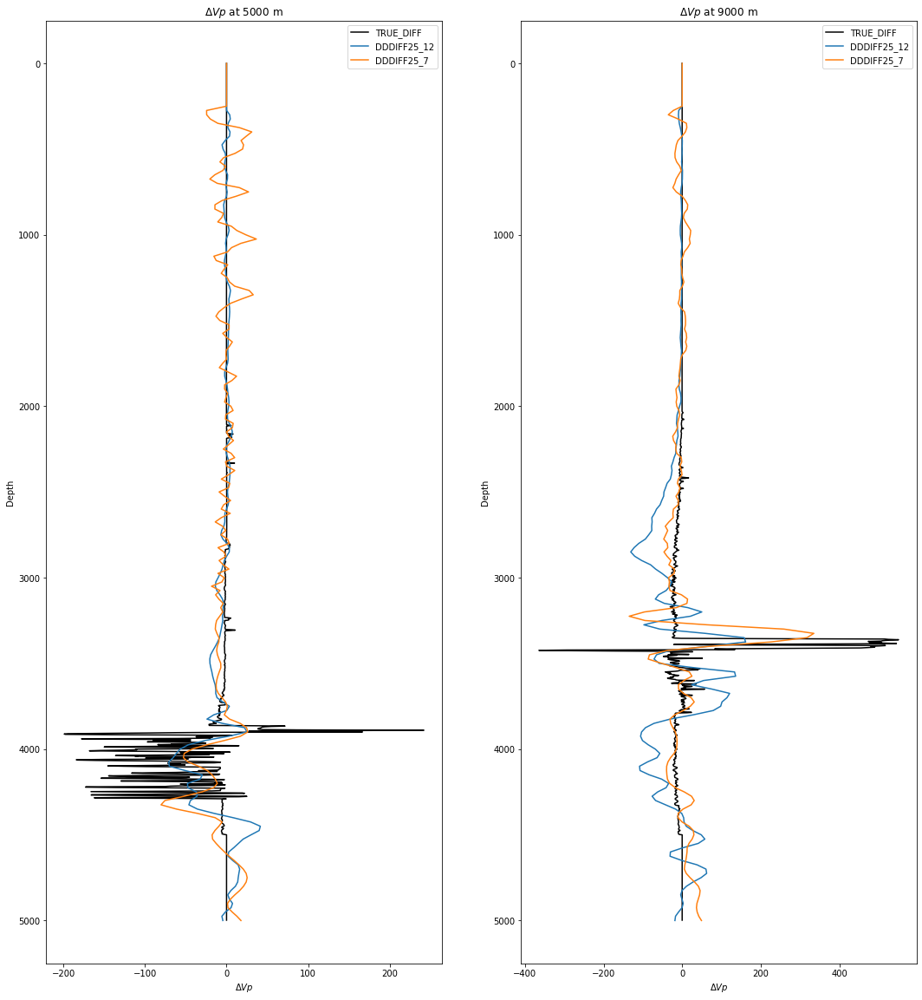

In [194]:
figure, ax = plt.subplots(1, 2)
figure.set_size_inches(9*2, 20)
ax[0].plot(tdiff12[0], yb, 'k', label="TRUE_DIFF")
ax[0].plot(ddiff12[0], y, label="DDDIFF25_12")
ax[0].plot(ddiff7[0], y, label="DDDIFF25_7")
ax[0].set_title(r"$\Delta Vp$ at %g m"%x_list[0])
ax[0].set_ylabel("Depth")
ax[0].set_xlabel(r"$\Delta Vp$")
ax[0].invert_yaxis()
ax[0].legend(loc="best")

ax[1].plot(tdiff12[1], yb, 'k', label="TRUE_DIFF")
ax[1].plot(ddiff12[1], y, label="DDDIFF25_12")
ax[1].plot(ddiff7[1], y, label="DDDIFF25_7")
ax[1].set_title(r"$\Delta Vp$ at %g m"%x_list[1])
ax[1].set_ylabel("Depth")
ax[1].set_xlabel(r"$\Delta Vp$")
ax[1].invert_yaxis()
ax[1].legend(loc="best")
plt.show()